In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import torch

from diffdrr.data import load_example_ct, read
from diffdrr.drr import DRR
from diffdrr.visualization import plot_drr

sns.set_context("talk")

read (volume:str|pathlib.Path|torchio.data.image.ScalarImage,
       labelmap:str|pathlib.Path|torchio.data.image.LabelMap=None,
       labels:int|list=None, orientation:str='AP',
       bone_attenuation_multiplier:float=1.0, **kwargs)

In [2]:
link=r"C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0067\01-01-2000-NA-NA-71158\3000708.000000-NA-21600"

In [3]:
import matplotlib.pyplot as plt
import torch

from diffdrr.drr import DRR
from diffdrr.data import load_example_ct
from diffdrr.visualization import plot_drr

In [2]:
import os

In [5]:
def show(link):
    # Read in the volume and get its origin and spacing in world coordinates
    subject = read(link, labelmap=None, labels=None, orientation="AP", bone_attenuation_multiplier=1.0)

    # Initialize the DRR module for generating synthetic X-rays
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    drr = DRR(
        subject,     # An object storing the CT volume, origin, and voxel spacing
        sdd=1020.0,  # Source-to-detector distance (i.e., focal length)
        height=200,# Image height (if width is not provided, the generated DRR is square)
        delx=2.0, # Pixel spacing (in mm)
    ).to(device)

    # Set the camera pose with rotations (yaw, pitch, roll) and translations (x, y, z)
    rotations = torch.tensor([[0.0, 0.0, 0.0]], device=device)
    translations = torch.tensor([[0.0, 850.0, 0.0]], device=device)

    # 📸 Also note that DiffDRR can take many representations of SO(3) 📸
    # For example, quaternions, rotation matrix, axis-angle, etc...
    img = drr(rotations, translations, parameterization="euler_angles", convention="ZXY")
    plot_drr(img, ticks=False)
    
    plt.show()

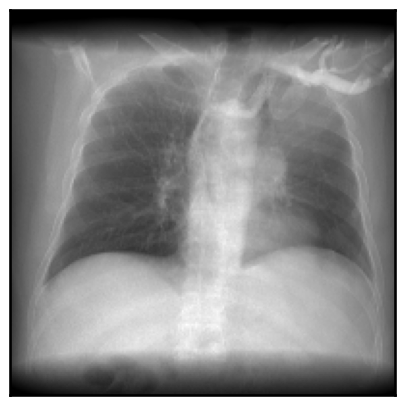

In [6]:
link=r"C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0067\01-01-2000-NA-NA-71158\3000708.000000-NA-21600"
show(link)

In [7]:
import os

In [8]:
list=[]

In [9]:
import os
import shutil

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0001\01-01-2000-NA-NA-30178\3000566.000000-NA-03192
LIDC-IDRI-0001


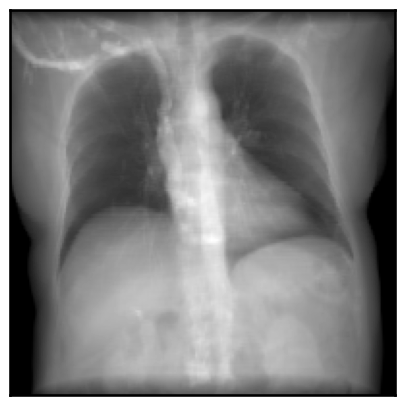

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0002\01-01-2000-NA-NA-98329\3000522.000000-NA-04919
LIDC-IDRI-0002


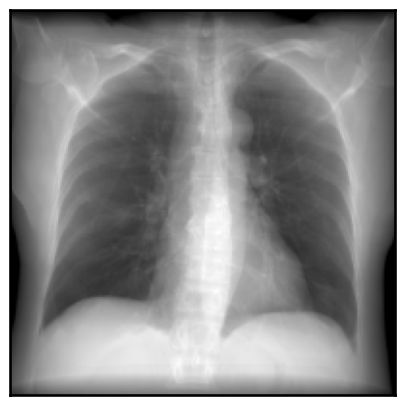

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0003\01-01-2000-NA-NA-94866\3000611.000000-NA-03264
LIDC-IDRI-0003


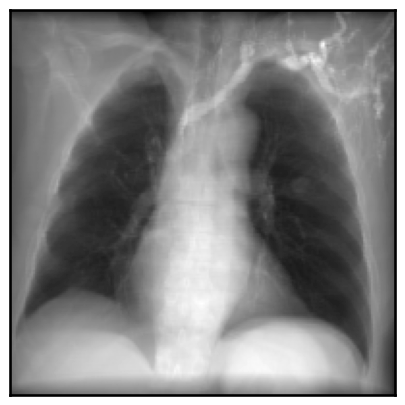

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0004\01-01-2000-NA-NA-91780\3000534.000000-NA-58228
LIDC-IDRI-0004


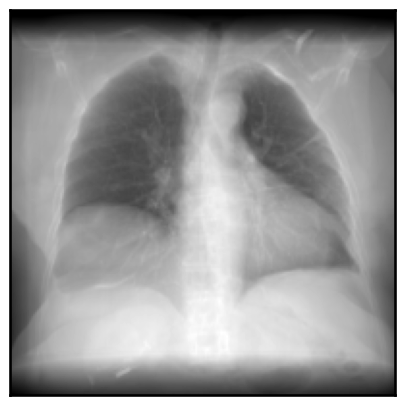

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0005\01-01-2000-NA-NA-42125\3000548.000000-NA-86225
LIDC-IDRI-0005


KeyboardInterrupt: 

In [10]:
folder=r"C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI"
for subfolder in os.listdir(folder):
    #list.append(str(os.path.join(folder,subfolder)))
    if subfolder=="LICENSE":
        continue
    link_subfolder=os.path.join(folder,subfolder)
    for subfolder1 in os.listdir(link_subfolder):
        folder_LIDC_IDRI=os.path.join(link_subfolder,subfolder1)
        sub1=next(os.walk(folder_LIDC_IDRI))[1]
        first_sub1=os.path.join(folder_LIDC_IDRI,sub1[0])
        print(first_sub1)
        num_files=len(os.listdir(first_sub1))
        if num_files>=10:
            print(subfolder)
            show(first_sub1)
        #len_folder=sum(os.path.join(first_sub1,item)) for item in os.listdir(first_sub1)
        

In [5]:
import os
import torch
import matplotlib.pyplot as plt

def show(link):
    try:
        # Read in the volume and get its origin and spacing in world coordinates
        subject = read(link, labelmap=None, labels=None, orientation="AP", bone_attenuation_multiplier=1.0)

        # Initialize the DRR module for generating synthetic X-rays
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        drr = DRR(
            subject,     # An object storing the CT volume, origin, and voxel spacing
            sdd=1020.0,  # Source-to-detector distance (i.e., focal length)
            height=200,  # Image height (if width is not provided, the generated DRR is square)
            delx=2.0,    # Pixel spacing (in mm)
        ).to(device)
        rotations = torch.tensor([[0.0, 0.0, 0.0]], device=device)
        translations = torch.tensor([[0.0, 850.0, 0.0]], device=device)
        img = drr(rotations, translations, parameterization="euler_angles", convention="ZXY")
        plot_drr(img, ticks=False)
        folder=r'E:\project\AI-Medical-Image-Processing\diffdrr\DiffDRR\images'
        a=link.find('LIDC-IDRI-')
        s=""
        if a!=-1:
            s=str(link[a:a+14])+".png"
        else:
            s=""
        file_path = os.path.join(folder, s)
        
        plt.savefig(file_path)
        plt.show()

    except Exception as e:
        print(f"An error occurred: {e}")

In [6]:
show(link)

An error occurred: File not found: "C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0067\01-01-2000-NA-NA-71158\3000708.000000-NA-21600"


Cắt ảnh được lưu trong file images

In [3]:
import os
from PIL import Image

def crop_images(folder):
    try:
        # Đảm bảo thư mục tồn tại
        if not os.path.exists(folder):
            print(f"Thư mục {folder} không tồn tại.")
            return
        
        # Duyệt qua tất cả các tệp trong thư mục
        for filename in os.listdir(folder):
            if filename.endswith(".png"):  # Kiểm tra nếu tệp là ảnh PNG
                file_path = os.path.join(folder, filename)
                
                # Mở ảnh
                with Image.open(file_path) as img:
                    # Chỉ định tọa độ cắt (left, top, right, bottom)
                    left = 321
                    top = 61
                    right = img.width - 294
                    bottom = img.height - 54
                    
                    # Cắt ảnh
                    img_cropped = img.crop((left, top, right, bottom))
                    
                    # Lưu ảnh đã cắt, ghi đè lên ảnh gốc
                    img_cropped.save(os.path.join('E:\project\AI-Medical-Image-Processing\diffdrr\DiffDRR\images_cropped2',filename))
                    print(f"Đã cắt và lưu {filename}")
    except Exception as e:
        print(f"Có lỗi xảy ra: {e}")

# Thư mục chứa các ảnh
folder = r'E:\project\AI-Medical-Image-Processing\diffdrr\DiffDRR\images'

# Cắt các ảnh trong thư mục với các tọa độ đã chỉ định
crop_images(folder)


Đã cắt và lưu LIDC-IDRI-0001.png
Đã cắt và lưu LIDC-IDRI-0002.png
Đã cắt và lưu LIDC-IDRI-0003.png
Đã cắt và lưu LIDC-IDRI-0004.png
Đã cắt và lưu LIDC-IDRI-0005.png
Đã cắt và lưu LIDC-IDRI-0006.png
Đã cắt và lưu LIDC-IDRI-0007.png
Đã cắt và lưu LIDC-IDRI-0008.png
Đã cắt và lưu LIDC-IDRI-0009.png
Đã cắt và lưu LIDC-IDRI-0010.png
Đã cắt và lưu LIDC-IDRI-0011.png
Đã cắt và lưu LIDC-IDRI-0012.png
Đã cắt và lưu LIDC-IDRI-0013.png
Đã cắt và lưu LIDC-IDRI-0014.png
Đã cắt và lưu LIDC-IDRI-0015.png
Đã cắt và lưu LIDC-IDRI-0016.png
Đã cắt và lưu LIDC-IDRI-0017.png
Đã cắt và lưu LIDC-IDRI-0018.png
Đã cắt và lưu LIDC-IDRI-0019.png
Đã cắt và lưu LIDC-IDRI-0020.png
Đã cắt và lưu LIDC-IDRI-0021.png
Đã cắt và lưu LIDC-IDRI-0022.png
Đã cắt và lưu LIDC-IDRI-0023.png
Đã cắt và lưu LIDC-IDRI-0024.png
Đã cắt và lưu LIDC-IDRI-0025.png
Đã cắt và lưu LIDC-IDRI-0026.png
Đã cắt và lưu LIDC-IDRI-0027.png
Đã cắt và lưu LIDC-IDRI-0028.png
Đã cắt và lưu LIDC-IDRI-0029.png
Đã cắt và lưu LIDC-IDRI-0030.png
Đã cắt và 

In [ ]:
import os
from PIL import Image

def crop_images(folder):
    try:       
        if not os.path.exists(folder):
            print(f"Thư mục {folder} không tồn tại.")
            return
        for filename in os.listdir(folder):
            if filename.endswith(".png"):
                file_path = os.path.join(folder, filename)
                with Image.open(file_path) as img:                    
                    left = 321
                    top = 51
                    right = img.width - 285
                    bottom = img.height - 44
                    img_cropped = img.crop((left, top, right, bottom))
                    img_cropped.save(os.path.join('E:\project\AI-Medical-Image-Processing\diffdrr\DiffDRR\images_cropped',filename))
                    print(f"Đã cắt và lưu {filename}")
    except Exception as e:
        print(f"Có lỗi xảy ra: {e}")

folder = r'E:\project\AI-Medical-Image-Processing\diffdrr\DiffDRR\images'
crop_images(folder)


C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0397\01-01-2000-NA-CHEST-76013\31211.000000-Recon 2 ACRIN LARGE-70818
LIDC-IDRI-0397


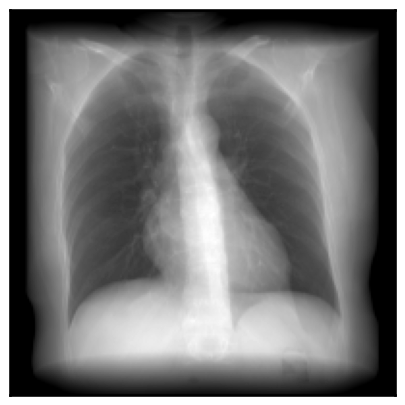

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0398\01-01-2000-NA-NA-61664\30075.000000-NA-54952
LIDC-IDRI-0398


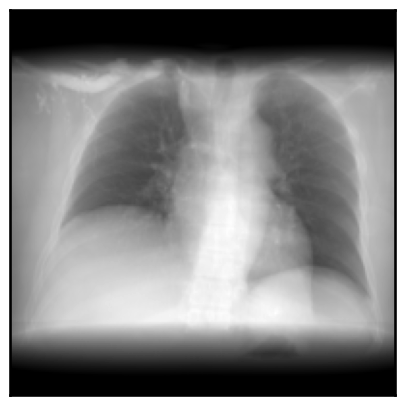

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0399\01-01-2000-NA-CT ANGIO CHEST NON-CO-97992\10.000000-Nodule 2 - Annotation 172681 evaluations-55534
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0400\01-01-2000-NA-NA-21605\3000013.000000-NA-17227
LIDC-IDRI-0400


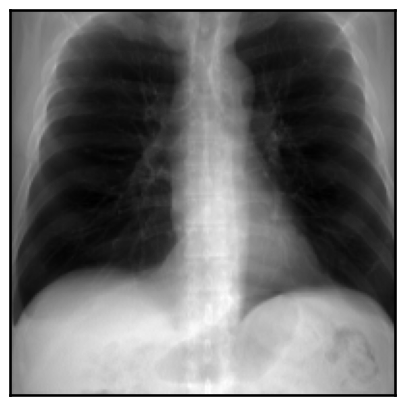

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0401\01-01-2000-NA-CT LUNG SCREEN-27699\NA-84519
LIDC-IDRI-0401


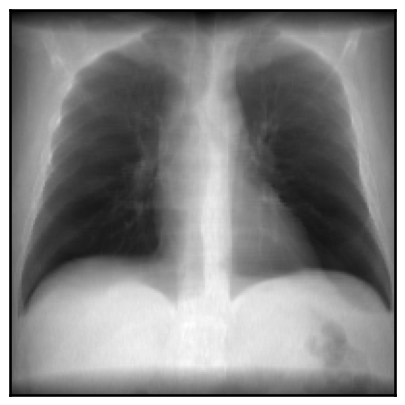

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0402\01-01-2000-NA-CT CHEST O CONTR-71869\10.000000-Nodule 1 - Annotation Nodule 015 evaluations-02872
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0403\01-01-2000-NA-NA-87070\5480.000000-Airway Study  1.25  B20s-33681
LIDC-IDRI-0403


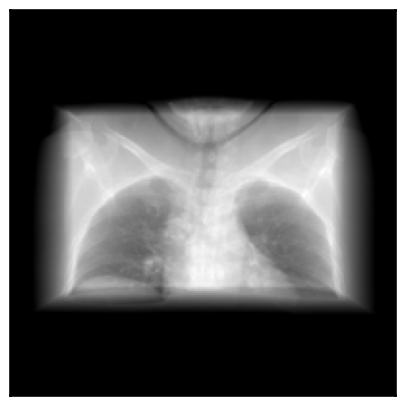

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0404\01-01-2000-NA-NA-58496\30045.000000-NA-00951
LIDC-IDRI-0404


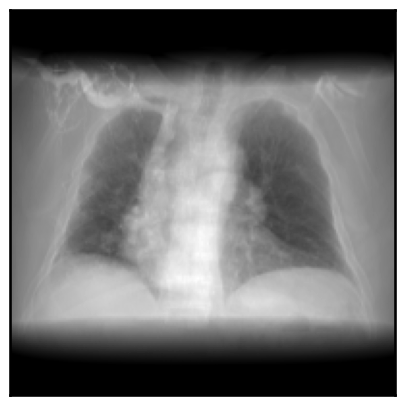

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0405\01-01-2000-NA-NA-51249\30078.000000-NA-51914
LIDC-IDRI-0405


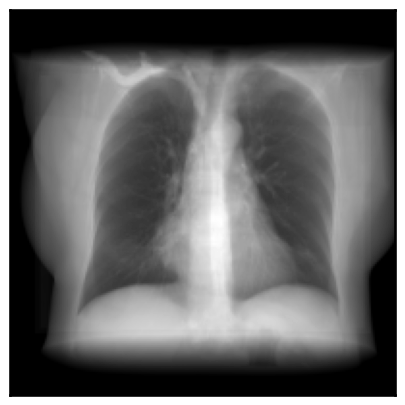

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0406\01-01-2000-NA-CHEST-67496\32142.000000-Recon 2 LOW DOSE THROUGH LUNGS-05022
LIDC-IDRI-0406


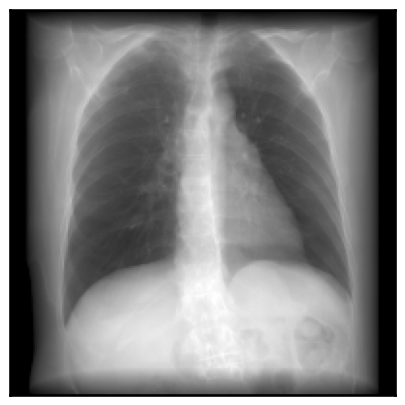

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0407\01-01-2000-NA-NA-10639\3000004.000000-NA-31179
LIDC-IDRI-0407


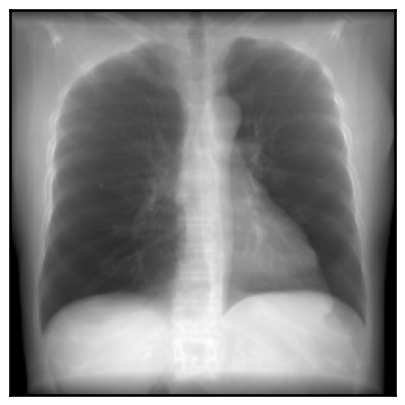

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0408\01-01-2000-NA-CT CHEST O CONTR-89975\10.000000-Nodule 1 - Annotation IL057157230 evaluations-72158
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0409\01-01-2000-NA-NA-32213\30082.000000-NA-69037
LIDC-IDRI-0409


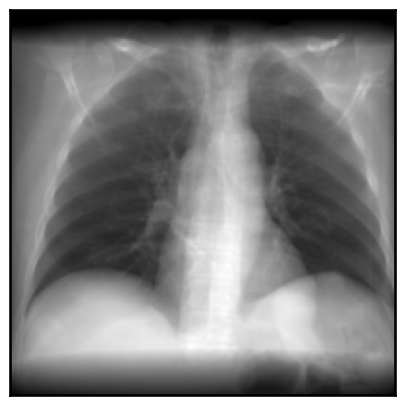

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0410\01-01-2000-NA-CT LUNG SCREEN-90336\NA-46543
LIDC-IDRI-0410


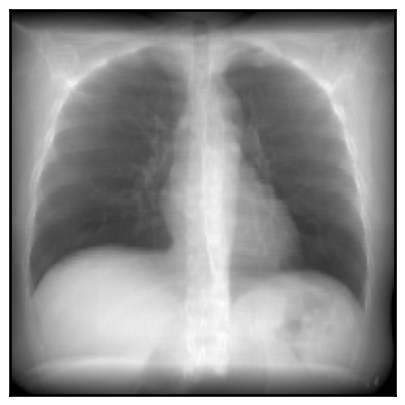

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0411\01-01-2000-NA-NA-84562\30732.000000-NA-94937
LIDC-IDRI-0411


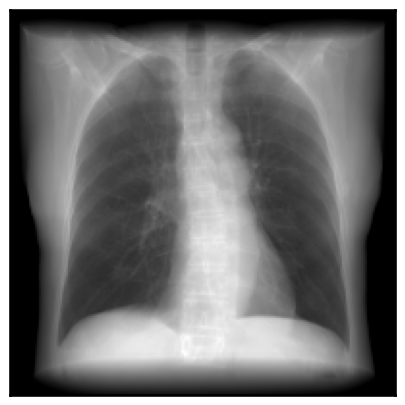

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0412\01-01-2000-NA-NA-79584\30049.000000-NA-08169
LIDC-IDRI-0412


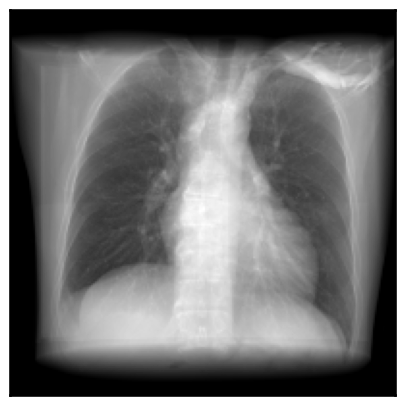

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0413\01-01-2000-NA-NA-05546\3000050.000000-NA-14231
LIDC-IDRI-0413


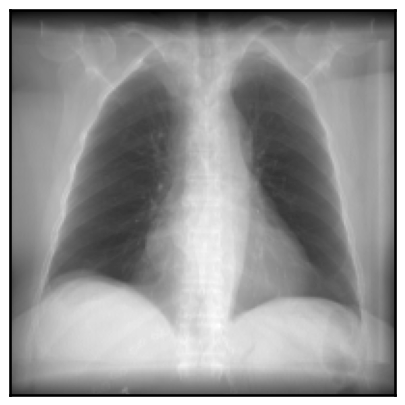

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0414\01-01-2000-NA-NA-33807\5439.000000-ThoraxRoutine  3.0  B31s-13435
LIDC-IDRI-0414


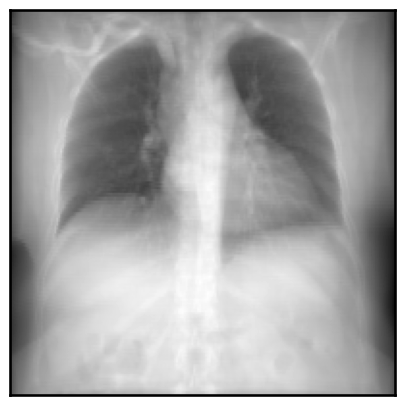

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0415\01-01-2000-NA-CT GUIDED LUNG BIOPSY-71720\10.000000-Nodule 1 - Annotation 0900 evaluations-08834
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0416\01-01-2000-NA-NA-59611\3000033.000000-NA-43951
LIDC-IDRI-0416


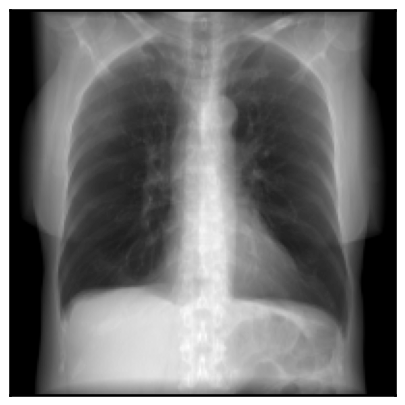

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0417\01-01-2000-NA-CT LUNG SCREEN-38390\NA-52296
LIDC-IDRI-0417


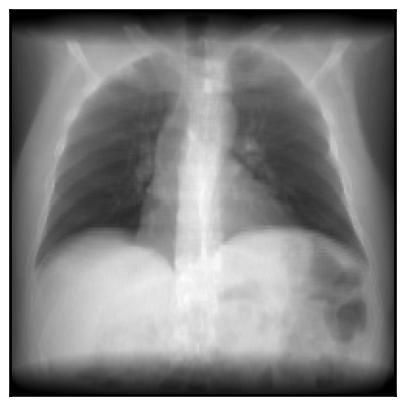

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0418\01-01-2000-NA-NA-71464\3000651.000000-NA-51680
LIDC-IDRI-0418


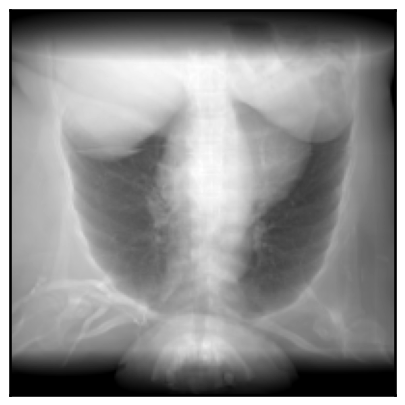

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0419\01-01-2000-NA-NA-91940\3000310.000000-NA-62027
LIDC-IDRI-0419


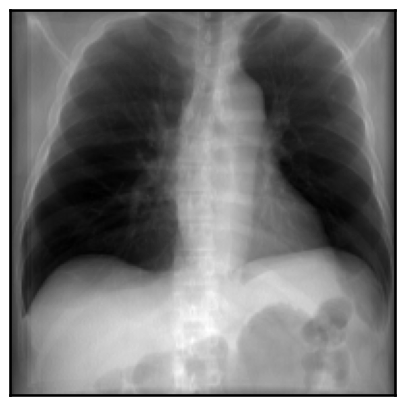

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0420\01-01-2000-NA-NA-57120\3000052.000000-NA-09377
LIDC-IDRI-0420


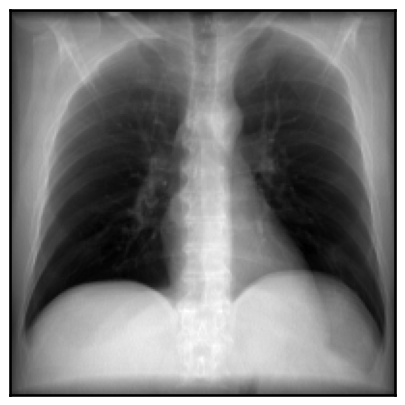

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0421\01-01-2000-NA-NA-94208\5185.000000-NA-27406
LIDC-IDRI-0421


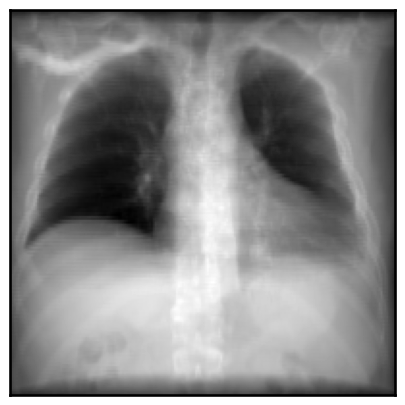

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0422\01-01-2000-NA-CT GUIDED LUNG BIOPSY-28835\3.000000-NA-26594
LIDC-IDRI-0422


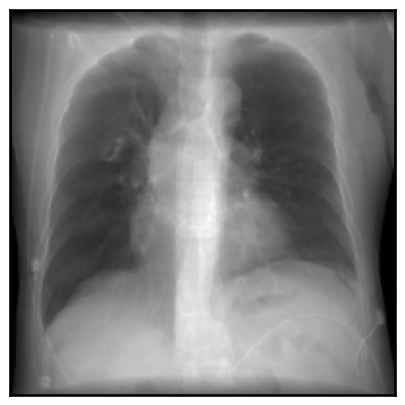

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0423\01-01-2000-NA-CT GUIDED LUNG B-90447\10.000000-Nodule 1 - Annotation 03419 evaluations-91284
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0424\01-01-2000-NA-NA-76209\3000682.000000-NA-83763
LIDC-IDRI-0424


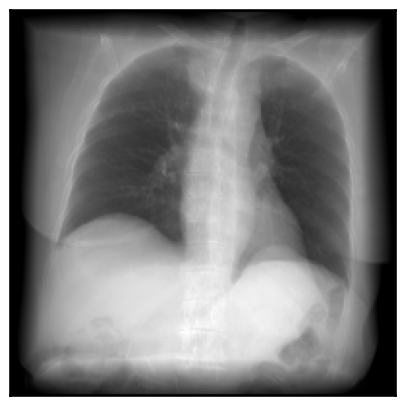

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0425\01-01-2000-NA-NA-47805\3000054.000000-NA-46285
LIDC-IDRI-0425


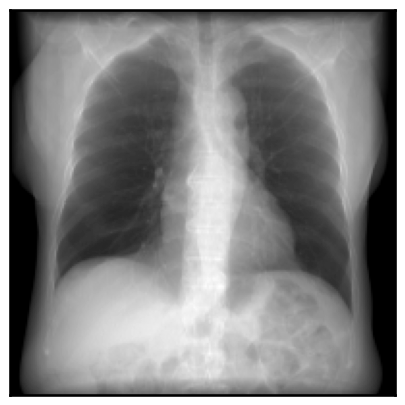

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0426\01-01-2000-NA-NA-19400\5923.000000-NA-80764
LIDC-IDRI-0426


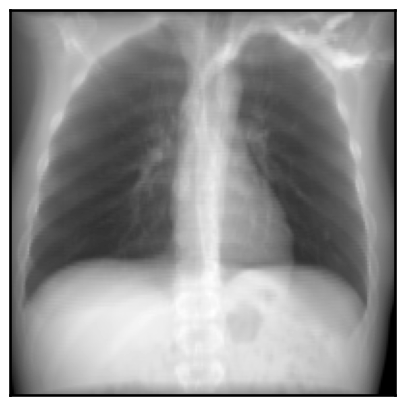

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0427\01-01-2000-NA-CT THORAX WO IV CONTRA-10457\31362.000000-Recon 2 ACRIN LARGE-77753
LIDC-IDRI-0427


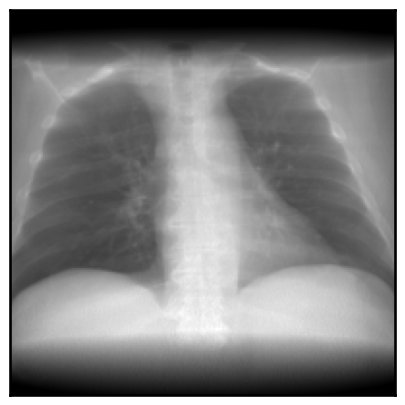

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0428\01-01-2000-NA-NA-45824\3000686.000000-NA-29132
LIDC-IDRI-0428


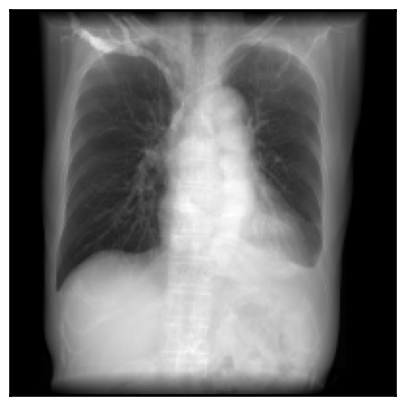

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0429\01-01-2000-NA-CT THORAX WO IV CONTRA-03396\32124.000000-Recon 2 ACRIN LARGE-74324
LIDC-IDRI-0429


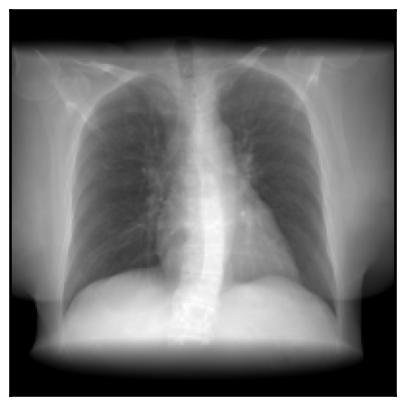

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0430\01-01-2000-NA-CHEST-99032\31276.000000-Recon 2 ACRIN LARGE-58431
LIDC-IDRI-0430


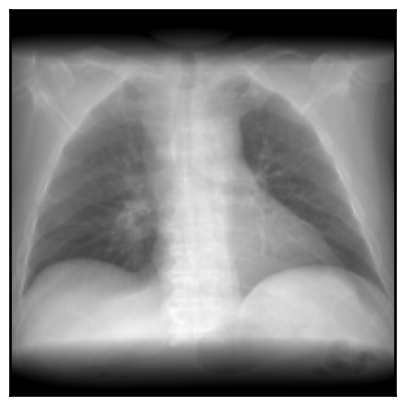

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0431\01-01-2000-NA-NA-23377\30841.000000-NA-59233
LIDC-IDRI-0431


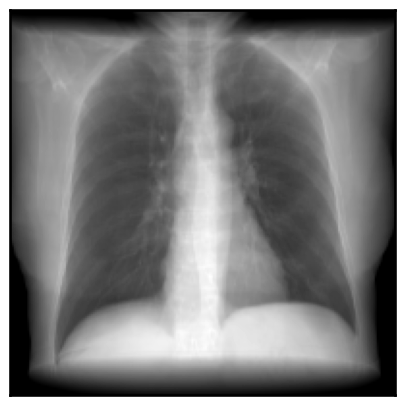

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0432\01-01-2000-NA-CT CHEST-81601\31470.000000-Recon 2 ACRIN SMALL-56742
LIDC-IDRI-0432


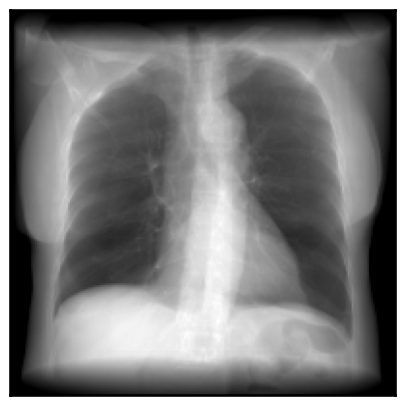

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0433\01-01-2000-NA-NA-27480\30056.000000-NA-55739
LIDC-IDRI-0433


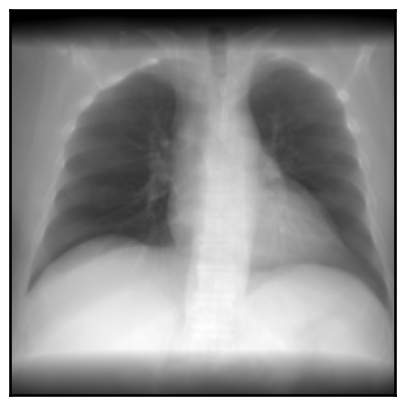

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0434\01-01-2000-NA-CHEST-46567\32113.000000-Recon 2 ACRIN LARGE-45498
LIDC-IDRI-0434


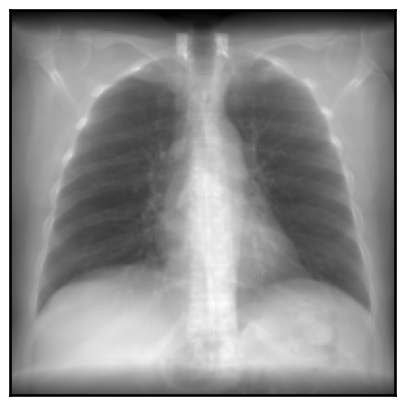

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0435\01-01-2000-NA-NA-91834\5359.000000-ThoraxRoutine  3.0  B31s-59686
LIDC-IDRI-0435


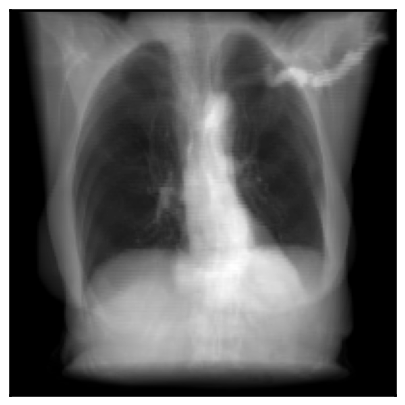

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0436\01-01-2000-NA-NA-51874\5348.000000-ChestRoutine  3.0  B31f-55181
LIDC-IDRI-0436


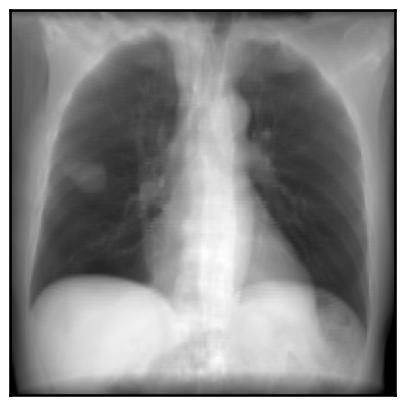

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0437\01-01-2000-NA-CHEST-35088\31028.000000-Recon 2 ACRIN LARGE-13632
LIDC-IDRI-0437


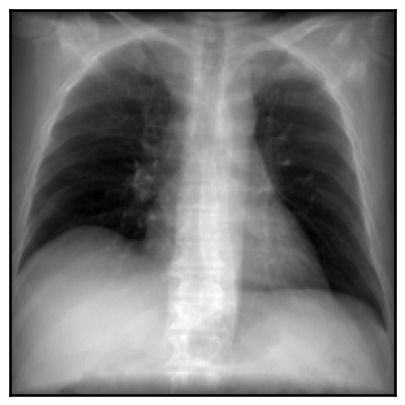

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0438\01-01-2000-NA-NA-12522\4561.000000-NLST0.6 B30f-55354
LIDC-IDRI-0438


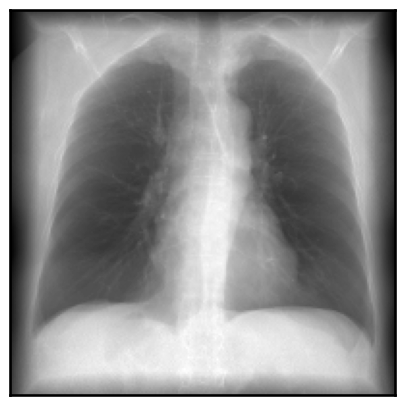

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0439\01-01-2000-NA-NA-05676\3102.000000-NA-08838
LIDC-IDRI-0439


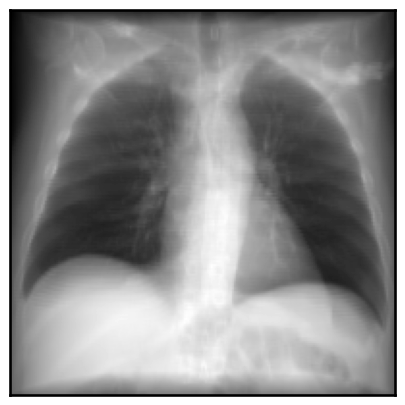

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0440\01-01-2000-NA-CT THORAX WO IV CONTRA-11794\32130.000000-Recon 2 ACRIN LARGE-35012
LIDC-IDRI-0440


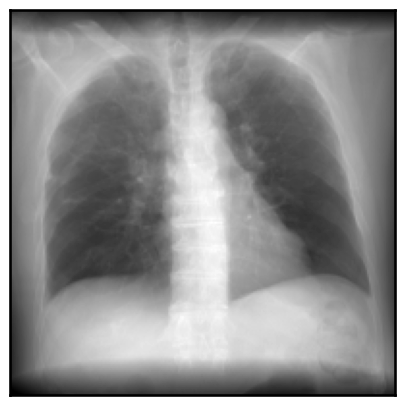

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0441\01-01-2000-NA-NA-51964\4063.000000-NLST0.6 B30f-30424
LIDC-IDRI-0441


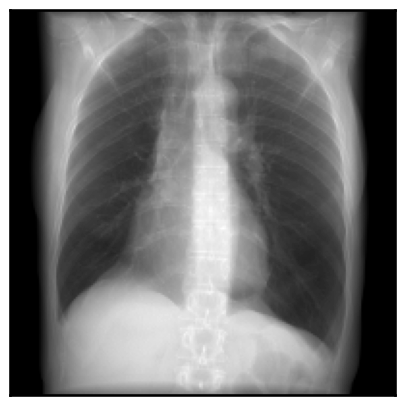

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0442\01-01-2000-NA-NA-70223\5405.000000-ThoraxRoutine  3.0  B31s-88309
LIDC-IDRI-0442


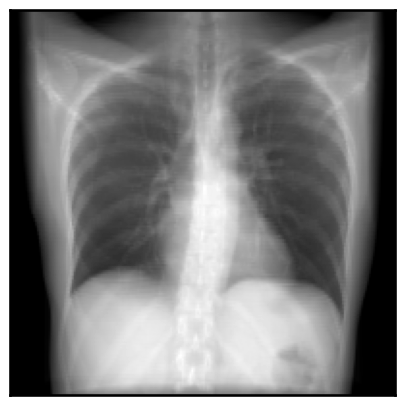

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0442\01-01-2000-NA-NA-74113\5472.000000-ThorRoutine  3.0  B31f-25941
LIDC-IDRI-0442


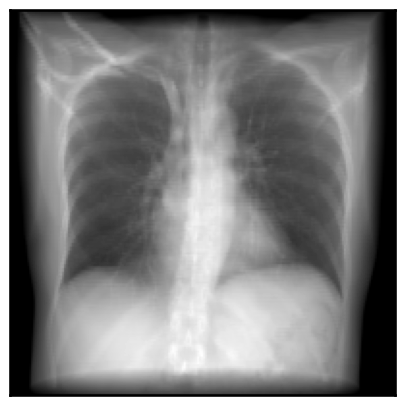

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0443\01-01-2000-NA-CT THORAX WO IV CONTRA-55156\32120.000000-Recon 2 ACRIN LARGE-35824
LIDC-IDRI-0443


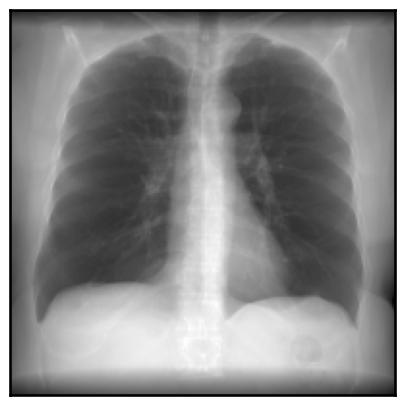

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0444\01-01-2000-NA-NA-25998\3000672.000000-NA-09754
LIDC-IDRI-0444


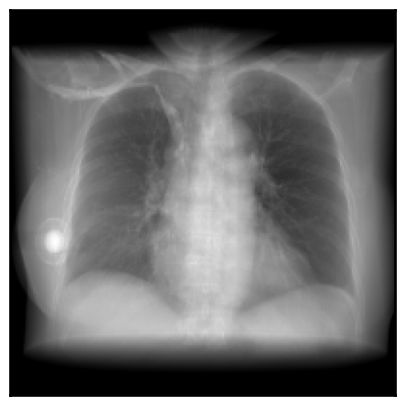

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0445\01-01-2000-NA-NA-90209\3000656.000000-NA-06008
LIDC-IDRI-0445


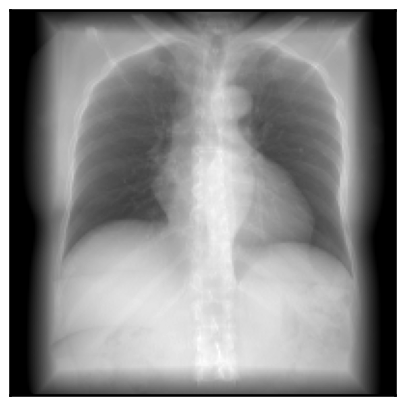

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0446\01-01-2000-NA-CT CHEST O CONTR-03519\NA-50446
LIDC-IDRI-0446


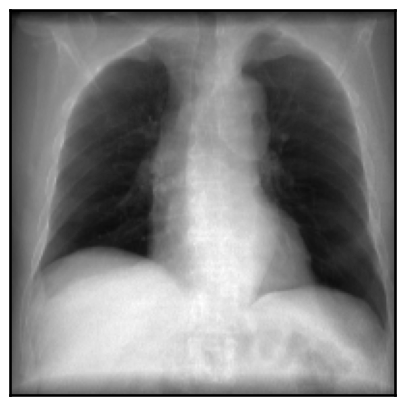

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0447\01-01-2000-NA-CT GUIDED LUNG B-56357\10.000000-Nodule 2 - Annotation 81210 evaluations-30109
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0448\01-01-2000-NA-NA-51374\30454.000000-NA-18032
LIDC-IDRI-0448


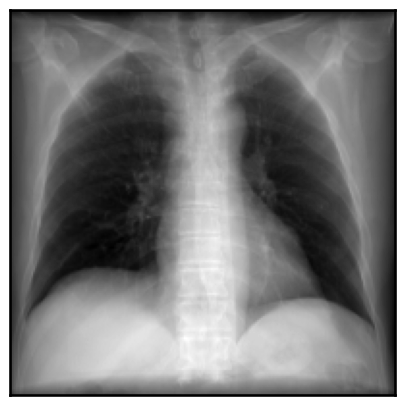

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0449\01-01-2000-NA-NA-47589\3231.000000-NA-88842
LIDC-IDRI-0449


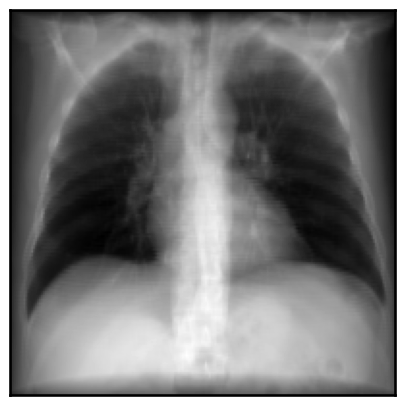

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0450\01-01-2000-NA-CT CHEST O CONTR-19747\1.000000-Segmentation of Nodule 1 - Annotation Nodule 001-60358
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0451\01-01-2000-NA-NA-43994\3000315.000000-NA-48244
LIDC-IDRI-0451


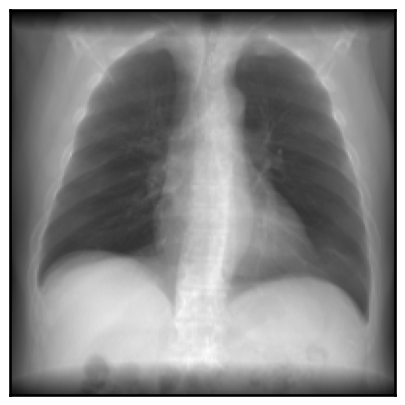

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0452\01-01-2000-NA-NA-11716\3000633.000000-NA-57505
LIDC-IDRI-0452


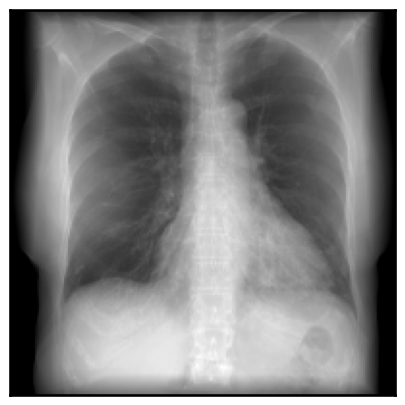

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0453\01-01-2000-NA-NA-68745\3000031.000000-NA-48856
LIDC-IDRI-0453


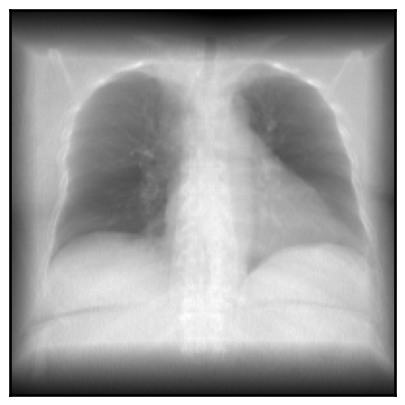

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0454\01-01-2000-NA-NA-73374\30029.000000-NA-25757
LIDC-IDRI-0454


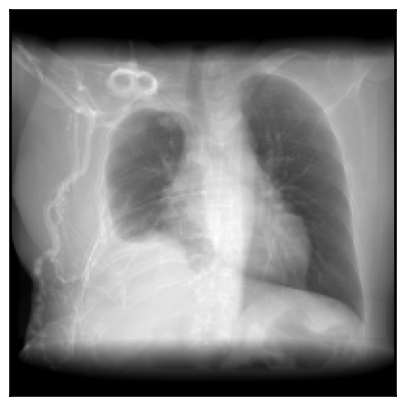

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0455\01-01-2000-NA-CT CHEST O CONTR-29059\2.000000-NA-61235
LIDC-IDRI-0455


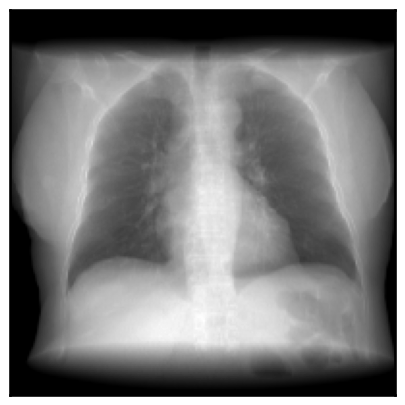

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0456\01-01-2000-NA-NA-27710\30055.000000-NA-22949
LIDC-IDRI-0456


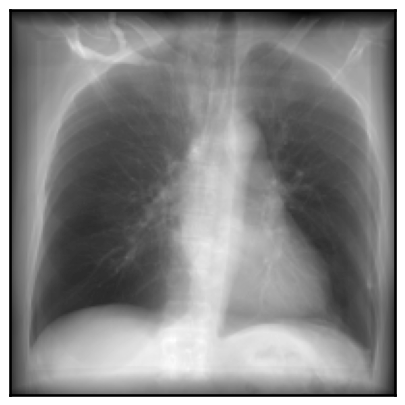

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0457\01-01-2000-NA-NA-85915\3000292.000000-NA-45513
LIDC-IDRI-0457


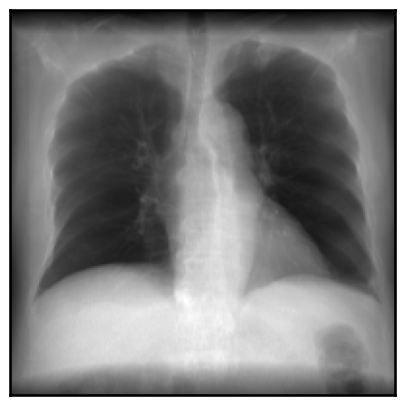

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0458\01-01-2000-NA-CT LUNG SCREEN-94789\1.000000-Segmentation of Nodule 1 - Annotation 0090-74762
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0459\01-01-2000-NA-CHEST-79708\32233.000000-NA-88500
LIDC-IDRI-0459


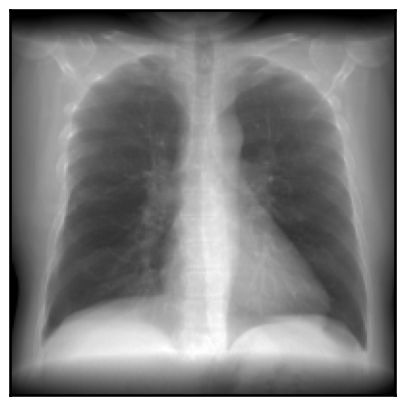

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0460\01-01-2000-NA-CT THORAX WO IV CONTRA-88233\32137.000000-Recon 2 ACRIN LARGE-77950
LIDC-IDRI-0460


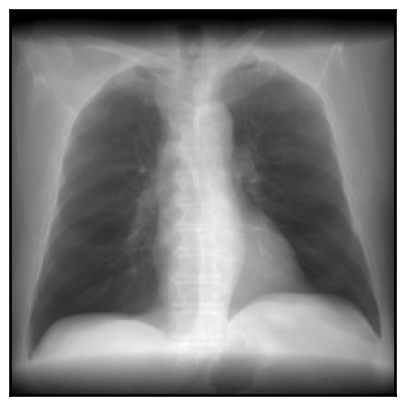

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0461\01-01-2000-NA-CT CHEST WO CONTRAST-16806\10.000000-Nodule 2 - Annotation 7446 evaluations-08328
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0462\01-01-2000-NA-CHEST-48602\30902.000000-Recon 2-08179
LIDC-IDRI-0462


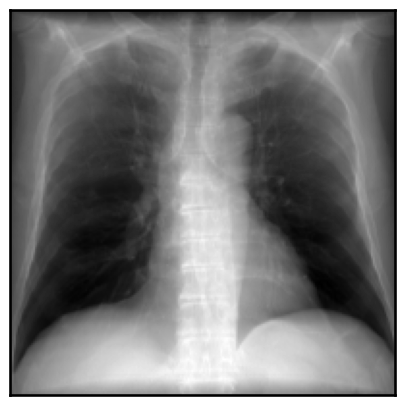

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0463\01-01-2000-NA-NA-54542\1695.000000-NLST TLC VOL B30F-34766
LIDC-IDRI-0463


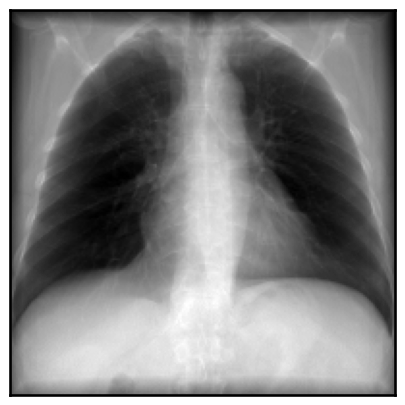

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0464\01-01-2000-NA-CT CHEST O CONTR-29869\10.000000-Nodule 3 - Annotation 48496 evaluations-57210
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0465\01-01-2000-NA-CT LUNG SCREEN-48726\NA-19526
LIDC-IDRI-0465


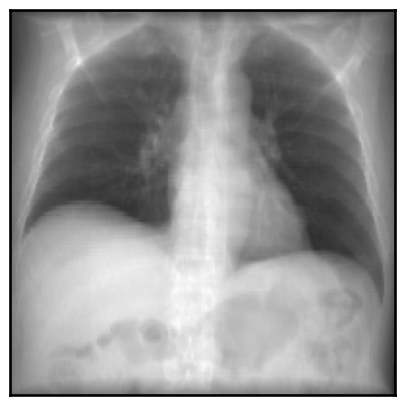

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0466\01-01-2000-NA-CT GUIDED LUNG B-88940\10.000000-Nodule 2 - Annotation IL057195964 evaluations-39562
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0467\01-01-2000-NA-NA-15541\30062.000000-NA-97495
LIDC-IDRI-0467


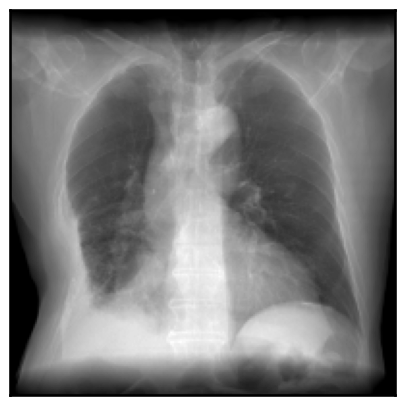

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0468\01-01-2000-NA-NA-36933\5753.000000-ThorRoutine  2.0  B70f-97516
LIDC-IDRI-0468


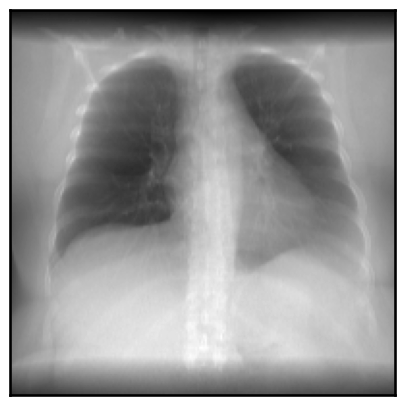

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0469\01-01-2000-NA-CHEST-67834\30906.000000-Recon 2 ACRIN LARGE-35112
LIDC-IDRI-0469


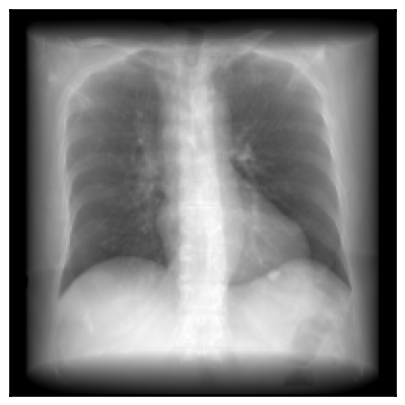

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0470\01-01-2000-NA-CT ANGIO CHEST NON-CO-32442\10.000000-Nodule 2 - Annotation 172331 evaluations-67563
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0471\01-01-2000-NA-CT LUNG SCREEN-64639\1.000000-Segmentation of Nodule 1 - Annotation Nodule 001-87957
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0472\01-01-2000-NA-CT LUNG SCREEN-39070\NA-12318
LIDC-IDRI-0472


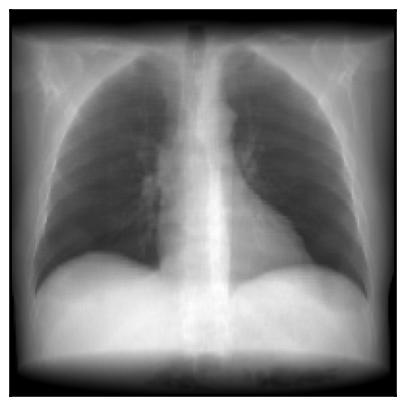

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0473\01-01-2000-NA-CT CHEST O CONTR-56991\1.000000-Segmentation of Nodule 1 - Annotation 0201-35650
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0474\01-01-2000-NA-NA-72976\3000045.000000-NA-66720
LIDC-IDRI-0474


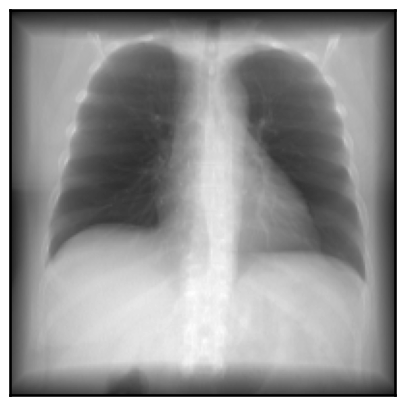

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0475\01-01-2000-NA-NA-24766\5926.000000-NA-69436
LIDC-IDRI-0475


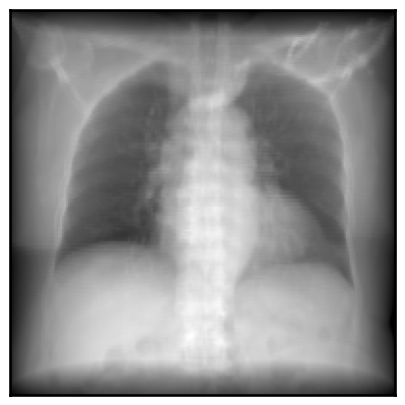

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0476\01-01-2000-NA-CT GUIDED LUNG B-77670\10.000000-Nodule 1 - Annotation 03426 evaluations-73466
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0477\01-01-2000-NA-CT CHEST O CONTR-77459\10.000000-Nodule 2 - Annotation Nodule 003 evaluations-46926
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0478\01-01-2000-NA-NA-96796\1386.000000-NLST TLC VOL B30F-01883
LIDC-IDRI-0478


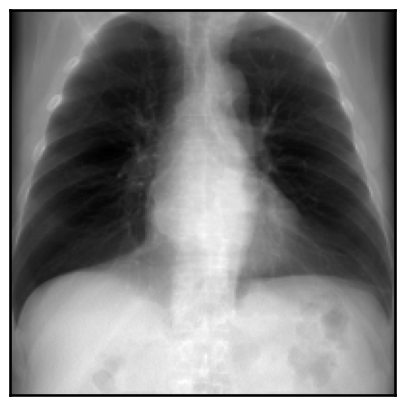

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0479\01-01-2000-NA-CHEST-13739\30894.000000-Recon 2 ACRIN LARGE-62827
LIDC-IDRI-0479


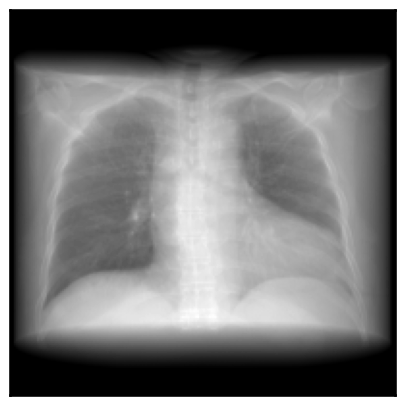

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0480\01-01-2000-NA-NA-96977\30459.000000-NA-08058
LIDC-IDRI-0480


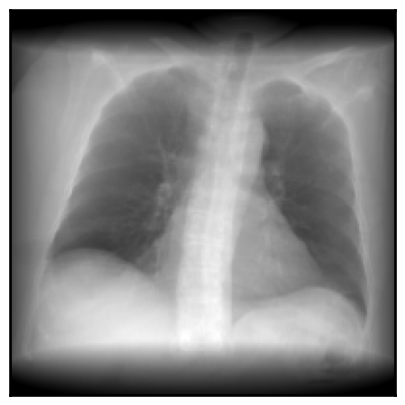

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0481\01-01-2000-NA-NA-73804\3000637.000000-NA-97306
LIDC-IDRI-0481


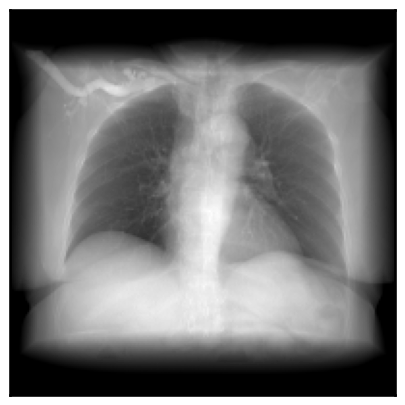

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0482\01-01-2000-NA-CT LUNG SCREEN-49585\NA-82371
LIDC-IDRI-0482


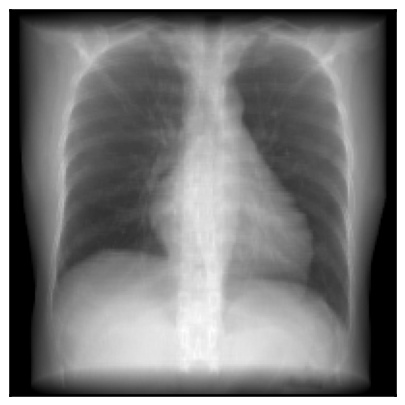

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0483\01-01-2000-NA-CT LUNG SCREEN-37152\2.000000-NA-34559
LIDC-IDRI-0483


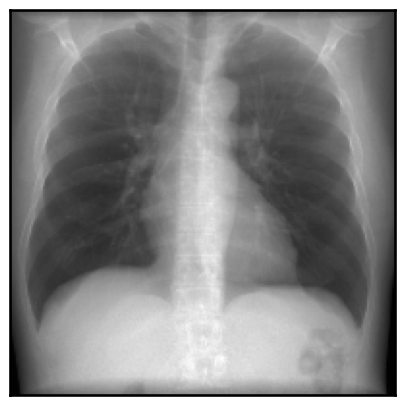

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0484\01-01-2000-NA-NA-28126\5417.000000-ChestRoutine  3.0  B31f-68211
LIDC-IDRI-0484


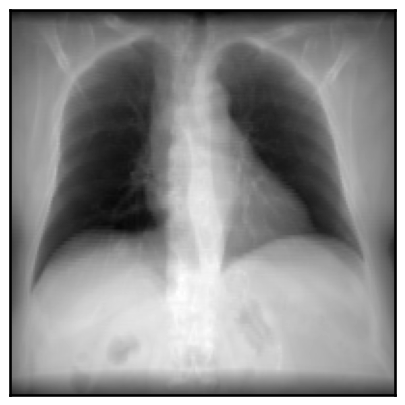

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0484\01-01-2000-NA-NA-71009\3100.000000-ChestRoutine  3.0  B31f-14351
LIDC-IDRI-0484


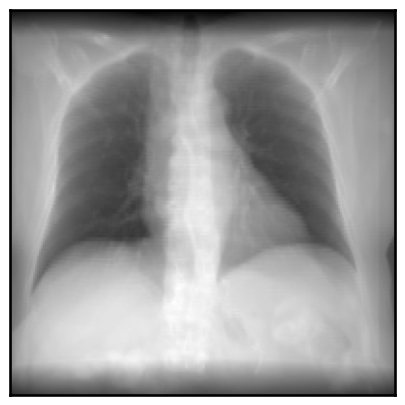

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0485\01-01-2000-NA-NA-23788\3000643.000000-NA-58535
LIDC-IDRI-0485


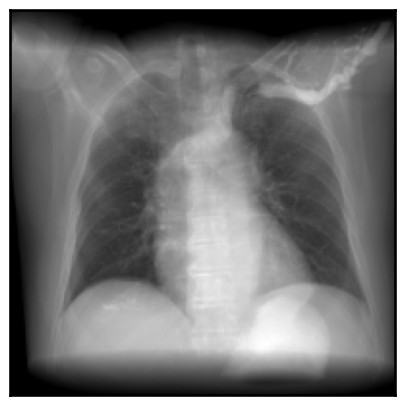

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0486\01-01-2000-NA-NA-01998\30057.000000-NA-80130
LIDC-IDRI-0486


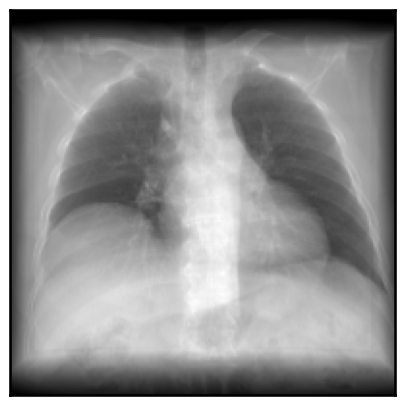

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0487\01-01-2000-NA-NA-57724\4155.000000-NLST TLC VOL B30F-21227
LIDC-IDRI-0487


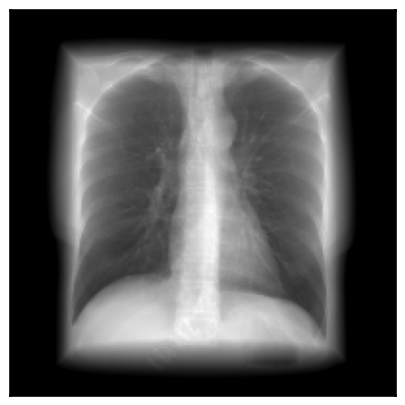

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0488\01-01-2000-NA-NA-32704\30719.000000-NA-68431
LIDC-IDRI-0488


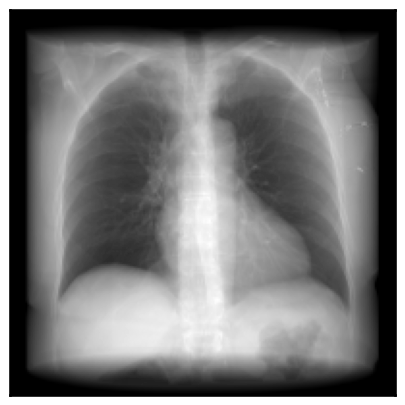

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0489\01-01-2000-NA-POST CHEST-95362\10.000000-Segmentation of Nodule 1 - Annotation Nodule 007-32662
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0490\01-01-2000-NA-NA-74089\30073.000000-NA-65775
LIDC-IDRI-0490


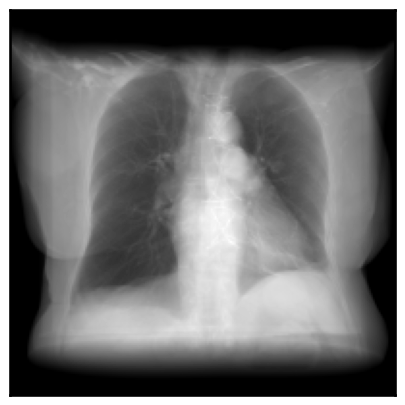

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0491\01-01-2000-NA-NA-20171\30324.000000-NA-97798
LIDC-IDRI-0491


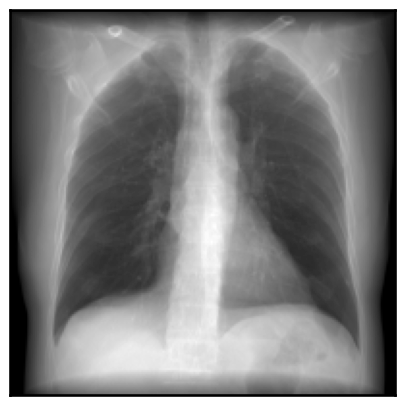

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0492\01-01-2000-NA-NA-66696\30070.000000-NA-26179
LIDC-IDRI-0492


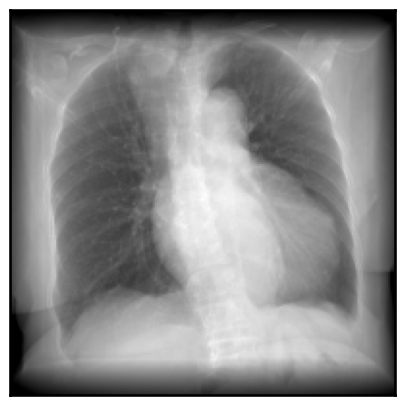

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0493\01-01-2000-NA-CHEST-24958\30943.000000-NA-48335
LIDC-IDRI-0493


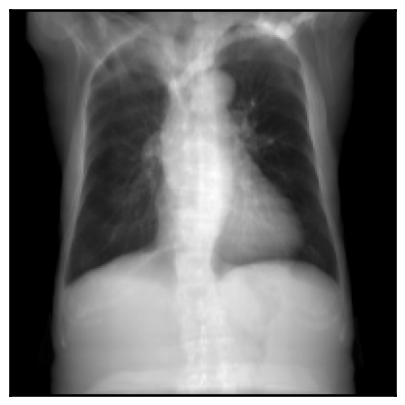

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0494\01-01-2000-NA-CT LUNG SCREEN-54823\1.000000-Segmentation of Nodule 1 - Annotation NIHCA13113-90342
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0495\01-01-2000-NA-NA-91791\3000677.000000-NA-48766
LIDC-IDRI-0495


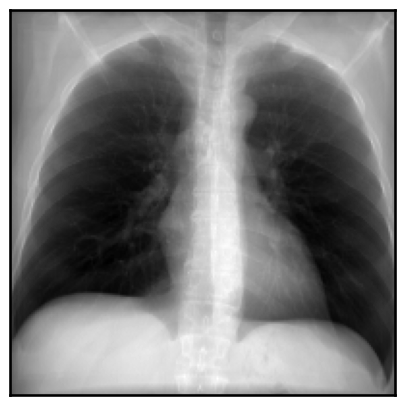

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0496\01-01-2000-NA-CT LUNG SCREEN-73273\10.000000-Nodule 1 - Annotation 40449 evaluations-45236
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0497\01-01-2000-NA-CT LUNG SCREEN-80488\10.000000-Nodule 1 - Annotation 8860 evaluations-18658
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0498\01-01-2000-NA-CHEST-00229\30910.000000-Recon 2 ACRIN LARGE-25349
LIDC-IDRI-0498


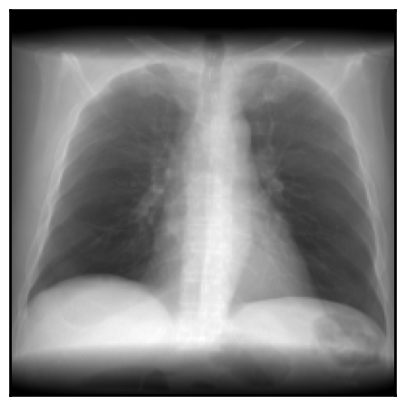

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0499\01-01-2000-NA-NA-39717\5421.000000-ChestRoutine  3.0  B31f-84037
LIDC-IDRI-0499


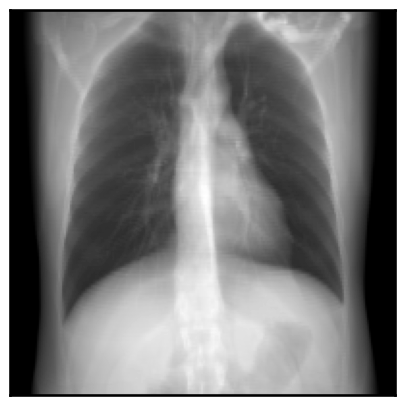

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0500\01-01-2000-NA-NA-80882\30827.000000-NA-15056
LIDC-IDRI-0500


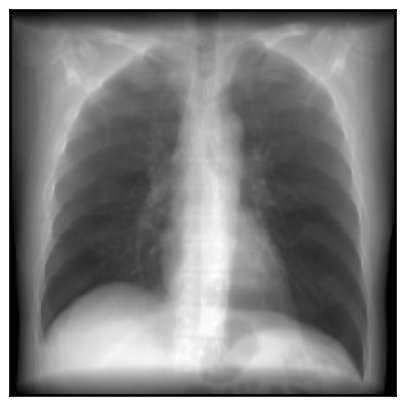

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0501\01-01-2000-NA-CT CHEST WO CONTRAST-83844\10.000000-Nodule 1 - Annotation 7420 evaluations-48166
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0502\01-01-2000-NA-CT LUNG SCREEN-86777\1.000000-Segmentation of Nodule 1 - Annotation Nodule 001-11416
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0503\01-01-2000-NA-NA-28519\3000029.000000-NA-66019
LIDC-IDRI-0503


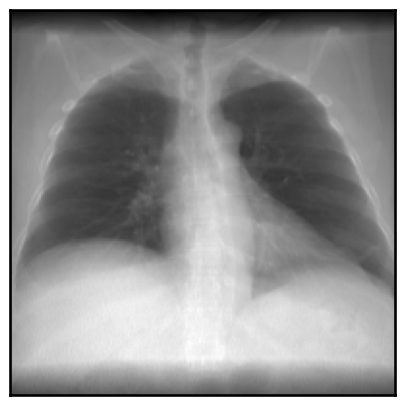

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0504\01-01-2000-NA-NA-92373\5925.000000-NA-68064
LIDC-IDRI-0504


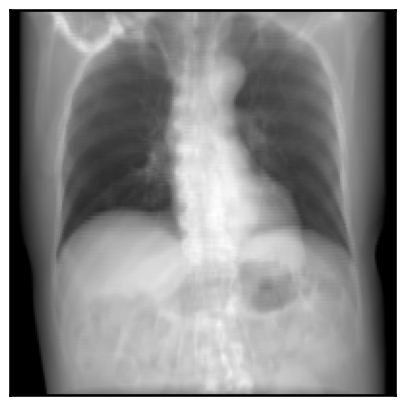

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0505\01-01-2000-NA-NA-29496\3000011.000000-NA-93165
LIDC-IDRI-0505


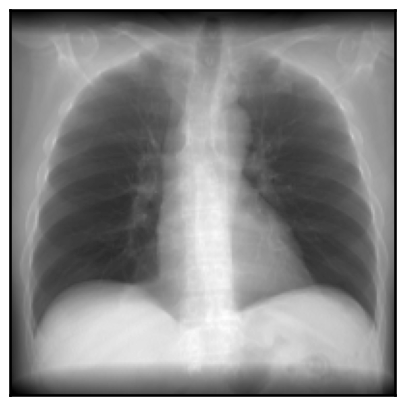

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0506\01-01-2000-NA-CHEST-93766\31172.000000-NA-49282
LIDC-IDRI-0506


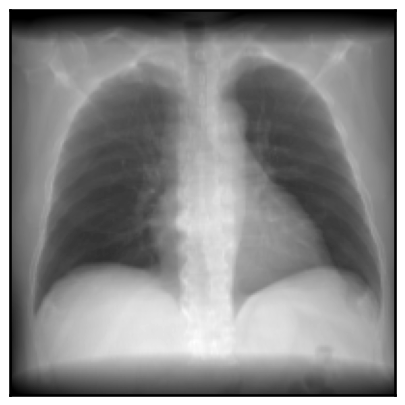

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0507\01-01-2000-NA-NA-84162\3000638.000000-NA-21986
LIDC-IDRI-0507


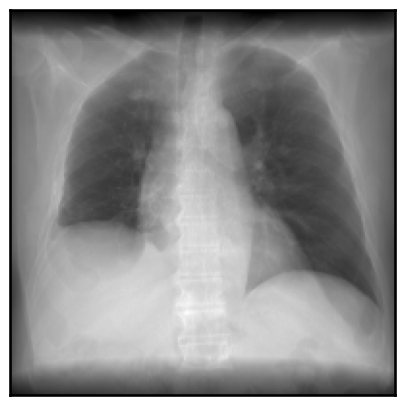

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0508\01-01-2000-NA-NA-44650\30076.000000-NA-74930
LIDC-IDRI-0508


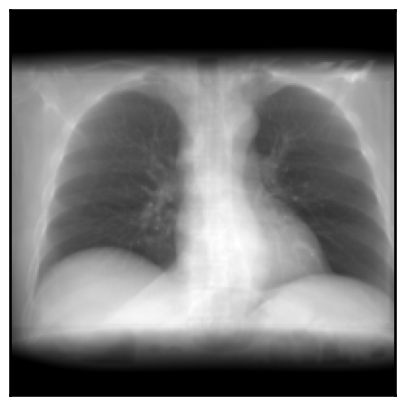

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0509\01-01-2000-NA-NA-89849\5467.000000-AbdRoutine  5.0  B31f-79828
LIDC-IDRI-0509


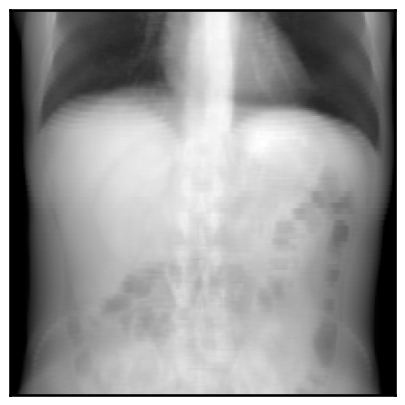

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0510\01-01-2000-NA-NA-17014\30017.000000-NA-21805
LIDC-IDRI-0510


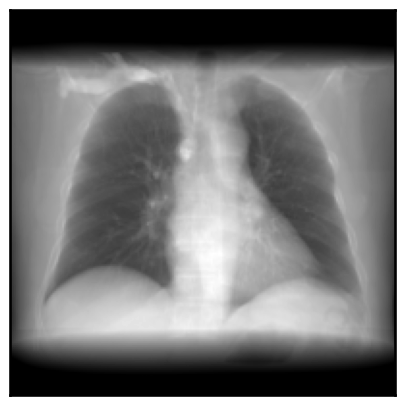

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0511\01-01-2000-NA-CT LUNG SCREEN-33498\NA-81056
LIDC-IDRI-0511


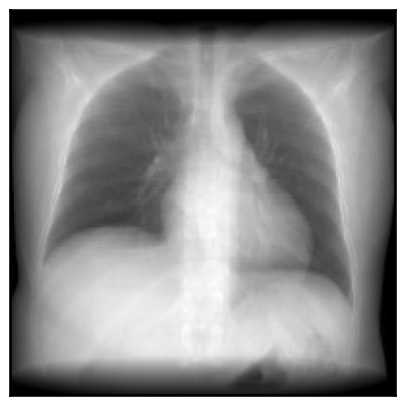

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0512\01-01-2000-NA-CT LUNG SCREEN-99446\NA-58572
LIDC-IDRI-0512


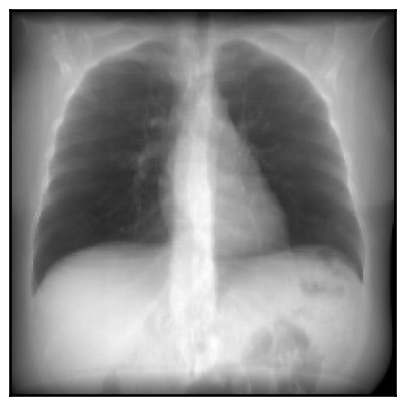

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0513\01-01-2000-NA-NA-18609\1595.000000-NLST TLC VOL B30F-68094
LIDC-IDRI-0513


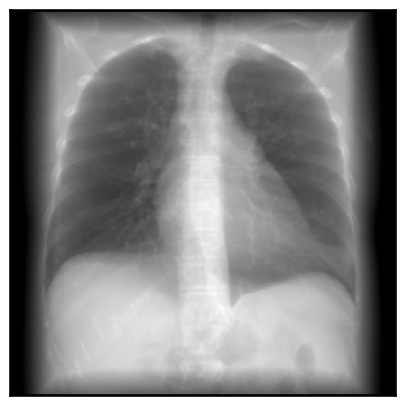

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0514\01-01-2000-NA-NA-87995\3000281.000000-NA-52230
LIDC-IDRI-0514


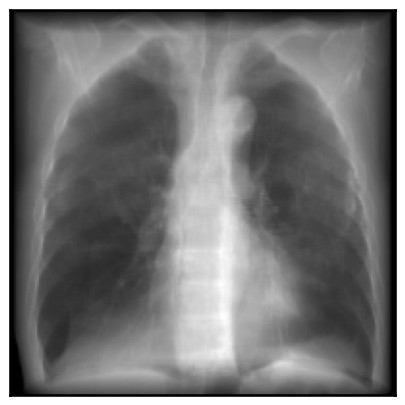

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0515\01-01-2000-NA-NA-22807\3000520.000000-NA-50295
LIDC-IDRI-0515


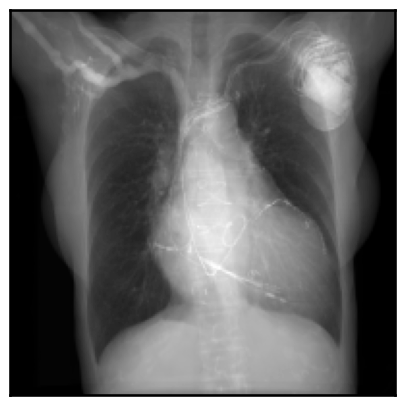

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0516\01-01-2000-NA-CT LUNG SCREEN-16499\1.000000-Segmentation of Nodule 1 - Annotation 1610-53146
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0517\01-01-2000-NA-CT LUNG SCREEN-04221\1.000000-Segmentation of Nodule 1 - Annotation 15358-83062
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0518\01-01-2000-NA-NA-43861\5922.000000-NA-53685
LIDC-IDRI-0518


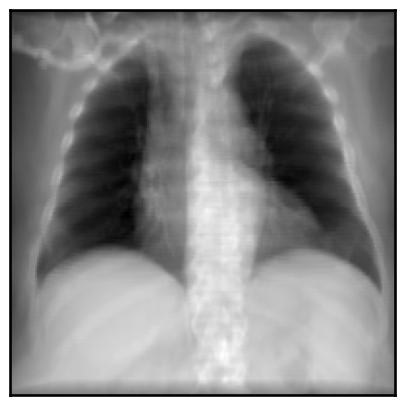

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0519\01-01-2000-NA-CT LUNG SCREEN-39681\NA-19413
LIDC-IDRI-0519


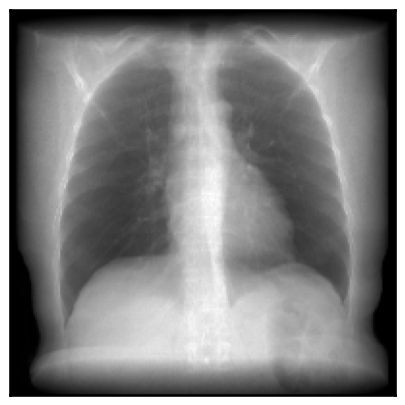

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0520\01-01-2000-NA-CHEST-63522\30914.000000-Recon 2-56430
LIDC-IDRI-0520


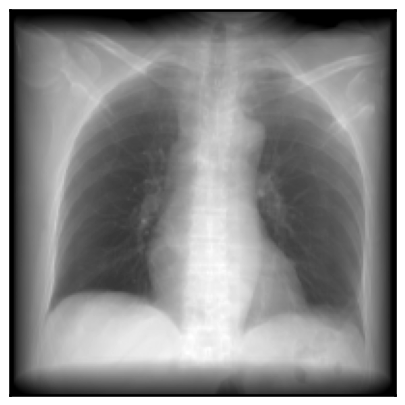

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0521\01-01-2000-NA-NA-16104\3000661.000000-NA-33473
LIDC-IDRI-0521


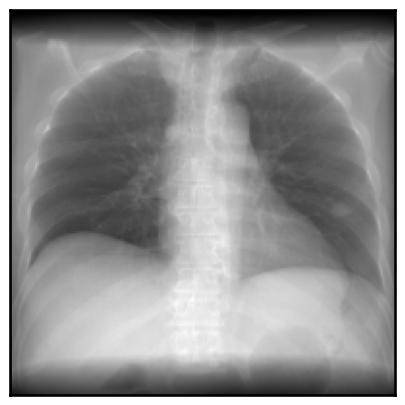

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0522\01-01-2000-NA-NA-10470\30014.000000-NA-77035
LIDC-IDRI-0522


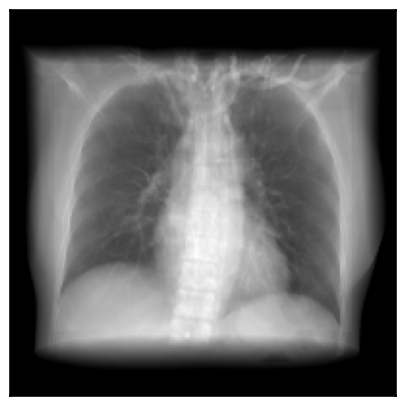

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0523\01-01-2000-NA-CT GUIDED LUNG B-18476\10.000000-Nodule 2 - Annotation 03397 evaluations-14282
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0524\01-01-2000-NA-NA-93738\1905.000000-NLST TLC VOL B30F-20378
LIDC-IDRI-0524


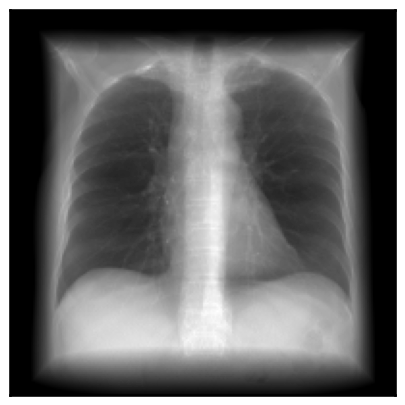

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0525\01-01-2000-NA-NA-26079\2016.000000-NLST TLC VOL B30F-03574
LIDC-IDRI-0525


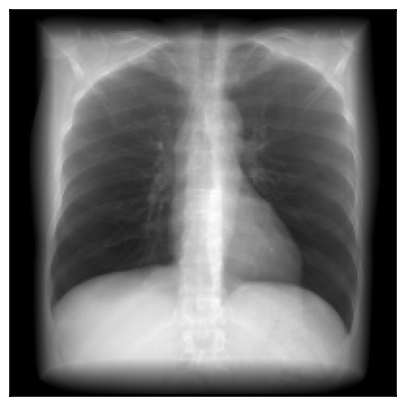

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0526\01-01-2000-NA-NA-43889\5443.000000-NA-51736
LIDC-IDRI-0526


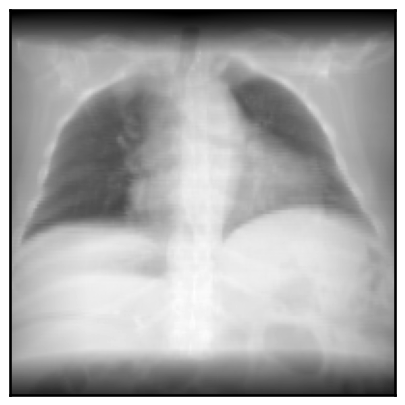

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0527\01-01-2000-NA-NA-75447\5485.000000-ChestRoutine  3.0  B31f-48007
LIDC-IDRI-0527


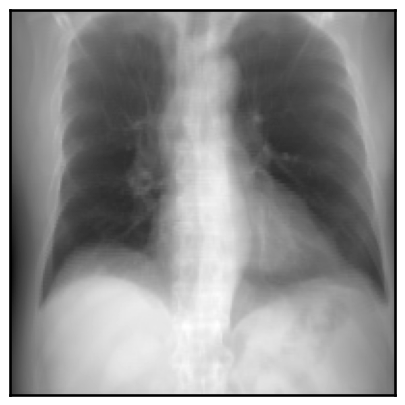

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0528\01-01-2000-NA-CT LUNG SCREEN-26958\NA-29176
LIDC-IDRI-0528


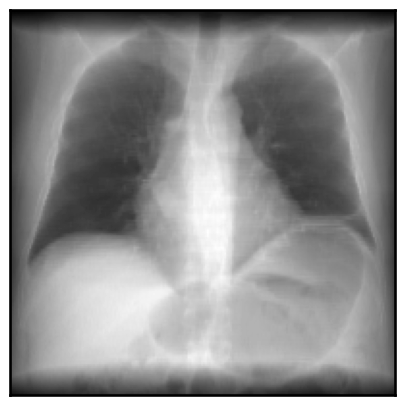

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0529\01-01-2000-NA-NA-79222\30366.000000-NA-53085
LIDC-IDRI-0529


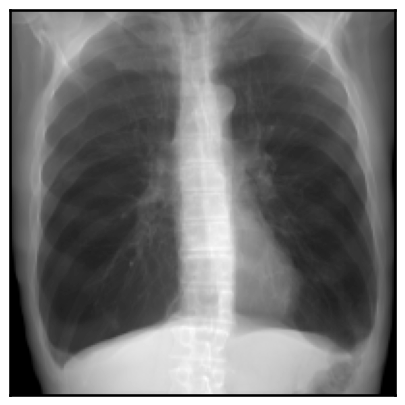

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0530\01-01-2000-NA-CHEST-77250\30889.000000-NA-98603
LIDC-IDRI-0530


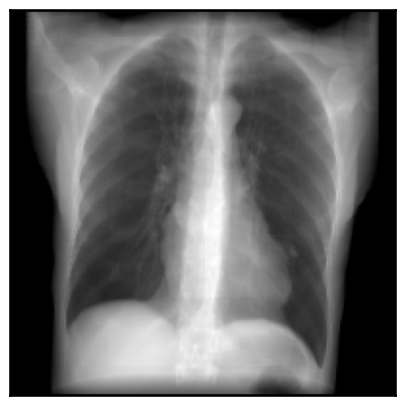

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0531\01-01-2000-NA-CT LUNG SCREEN-21135\NA-11064
LIDC-IDRI-0531


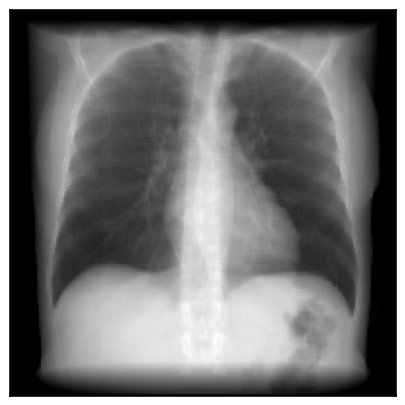

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0532\01-01-2000-NA-NA-24665\3000679.000000-NA-90027
LIDC-IDRI-0532


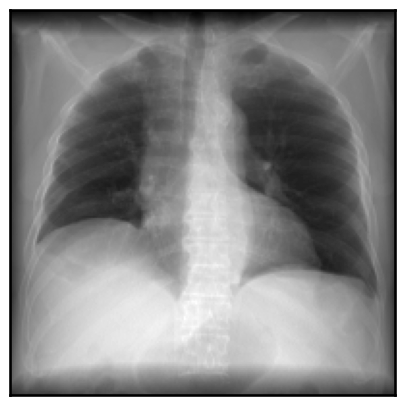

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0533\01-01-2000-NA-NA-78329\5354.000000-ChestRoutine  3.0  B31f-21367
LIDC-IDRI-0533


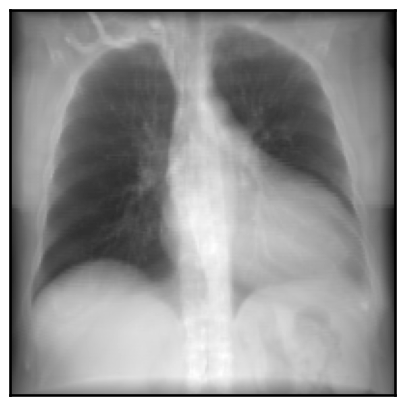

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0534\01-01-2000-NA-NA-89315\5473.000000-ThoraxRoutine  3.0  B31s-95151
LIDC-IDRI-0534


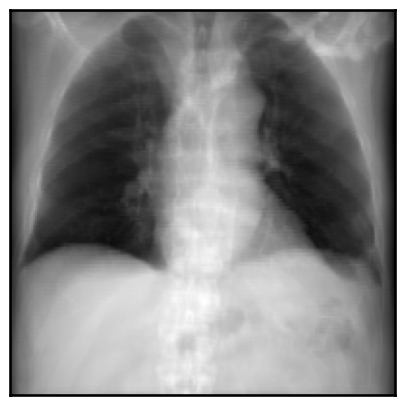

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0535\01-01-2000-NA-NA-14233\30033.000000-NA-96664
LIDC-IDRI-0535


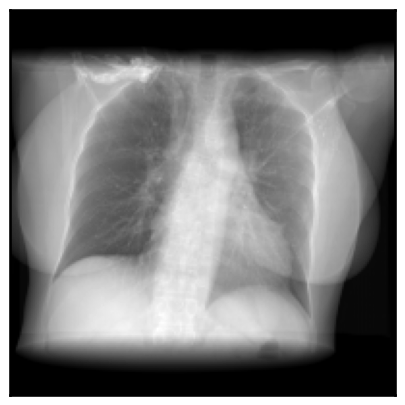

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0536\01-01-2000-NA-NA-32762\30456.000000-NA-23059
LIDC-IDRI-0536


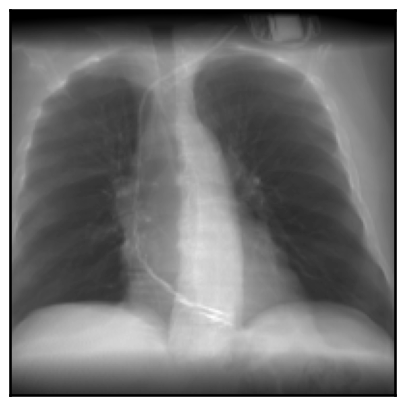

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0537\01-01-2000-NA-NA-70531\30797.000000-NA-80824
LIDC-IDRI-0537


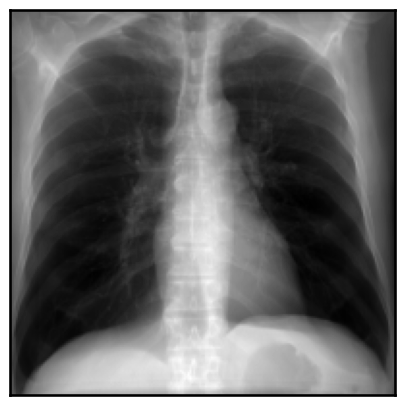

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0538\01-01-2000-NA-NA-74496\1889.000000-NLST TLC VOL B30F-13755
LIDC-IDRI-0538


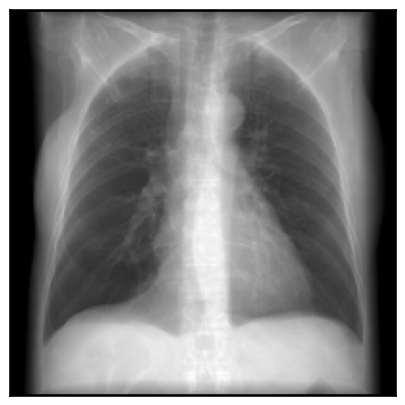

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0539\01-01-2000-NA-CT CHEST O CONTR-63297\2.000000-NA-86296
LIDC-IDRI-0539


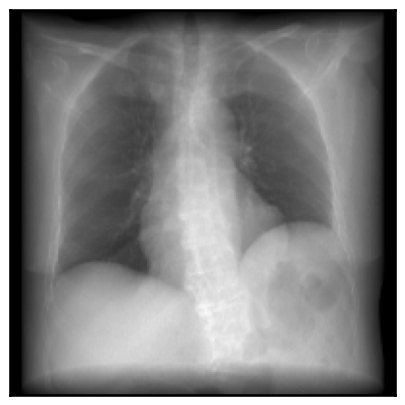

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0540\01-01-2000-NA-NA-03805\3000676.000000-NA-92782
LIDC-IDRI-0540


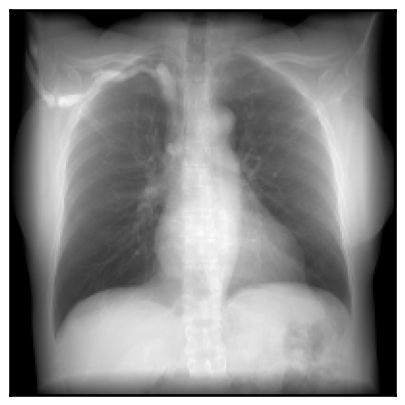

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0541\01-01-2000-NA-NA-89260\5515.000000-NA-39652
LIDC-IDRI-0541


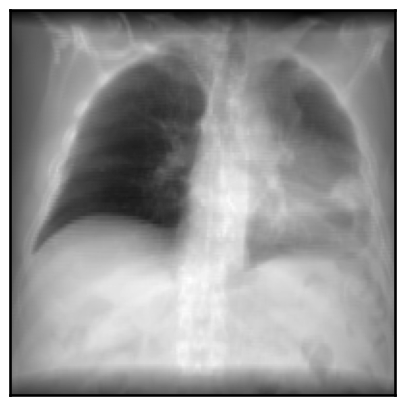

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0542\01-01-2000-NA-CHEST-89631\31184.000000-Recon 2-69557
LIDC-IDRI-0542


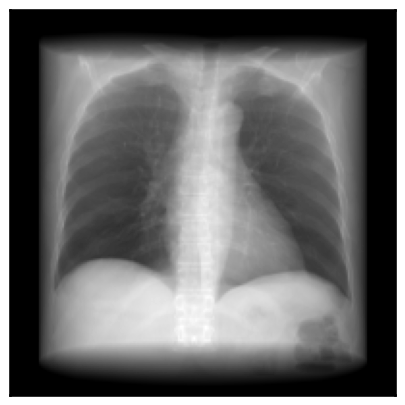

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0543\01-01-2000-NA-NA-45169\30006.000000-NA-79830
LIDC-IDRI-0543


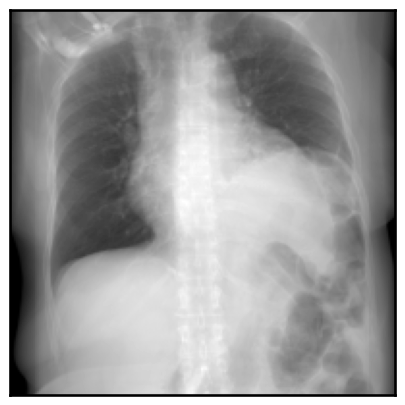

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0544\01-01-2000-NA-CT LUNG SCREEN-92547\NA-31442
LIDC-IDRI-0544


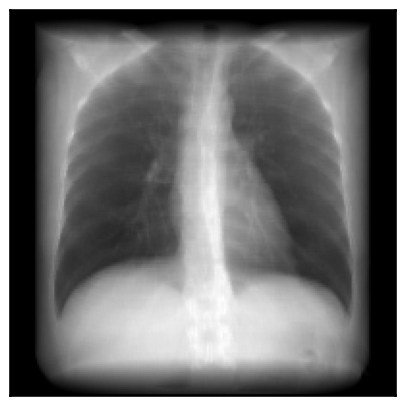

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0545\01-01-2000-NA-CHEST-53172\31181.000000-Recon 2 ACRIN LARGE-46863
LIDC-IDRI-0545


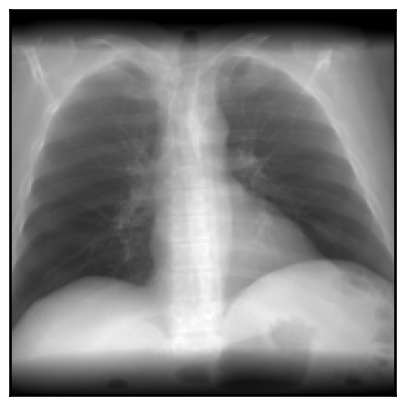

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0546\01-01-2000-NA-NA-72276\5758.000000-ChestRoutine  2.0  B70f-17281
LIDC-IDRI-0546


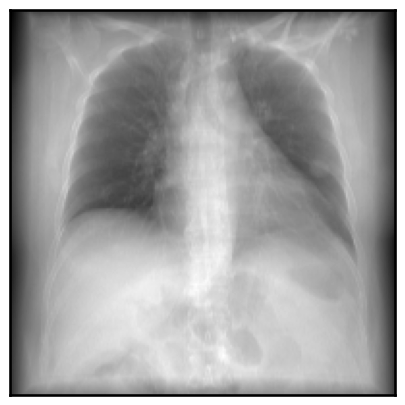

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0547\01-01-2000-NA-CHEST-51638\30883.000000-NA-08416
LIDC-IDRI-0547


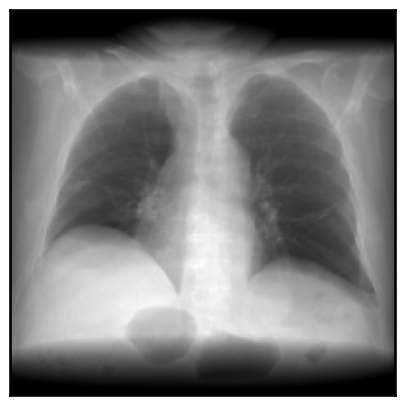

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0548\01-01-2000-NA-e1 CT LUNG SCREEN-12906\NA-81626
LIDC-IDRI-0548


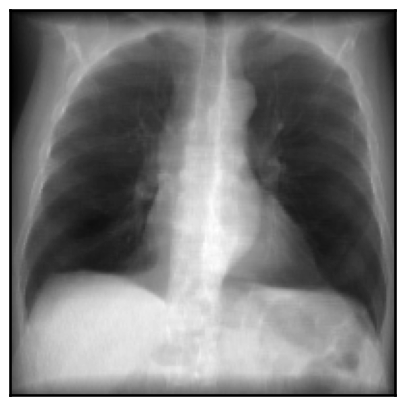

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0549\01-01-2000-NA-CT LUNG SCREEN-09475\1.000000-Segmentation of Nodule 1 - Annotation 7025-91339
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0550\01-01-2000-NA-NA-97204\5189.000000-NA-42208
LIDC-IDRI-0550


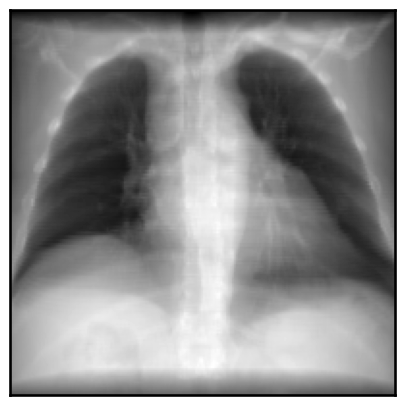

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0551\01-01-2000-NA-NA-54069\30749.000000-NA-88562
LIDC-IDRI-0551


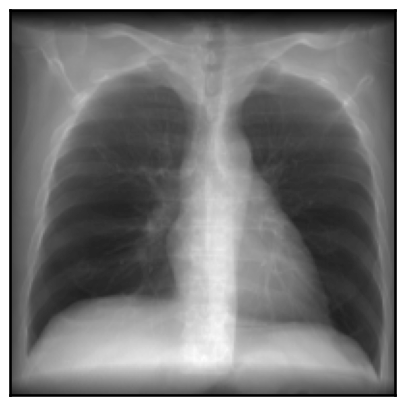

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0552\01-01-2000-NA-CT LUNG SCREEN-82803\1.000000-Segmentation of Nodule 1 - Annotation 8917-53239
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0553\01-01-2000-NA-CHEST-41756\32228.000000-Recon 2 ACRIN LARGE-52285
LIDC-IDRI-0553


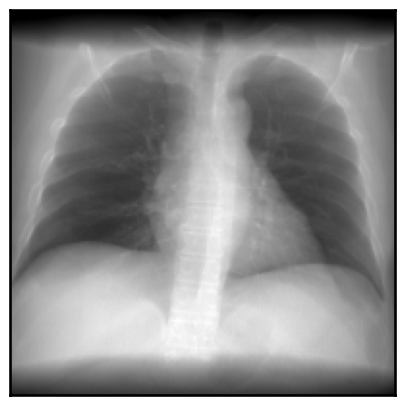

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0554\01-01-2000-NA-NA-64555\3000684.000000-NA-01943
LIDC-IDRI-0554


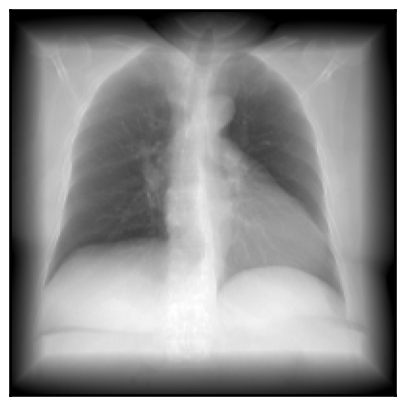

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0555\01-01-2000-NA-CT LUNG SCREEN-71520\1.000000-Segmentation of Nodule 1 - Annotation IL05785556-75386
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0556\01-01-2000-NA-NA-43956\30079.000000-NA-96518
LIDC-IDRI-0556


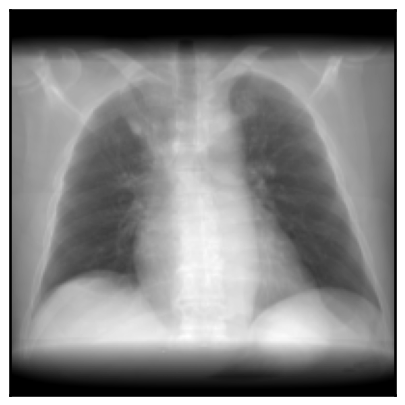

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0557\01-01-2000-NA-NA-65836\1854.000000-NLST TLC VOL B30F-00950
LIDC-IDRI-0557


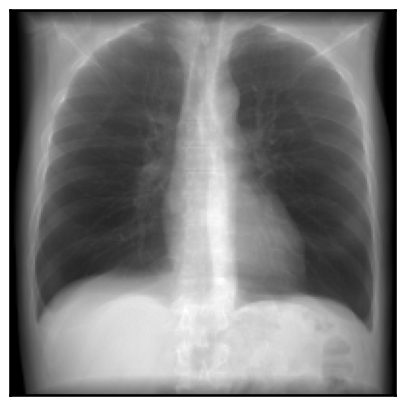

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0558\01-01-2000-NA-NA-43644\30010.000000-NA-92603
LIDC-IDRI-0558


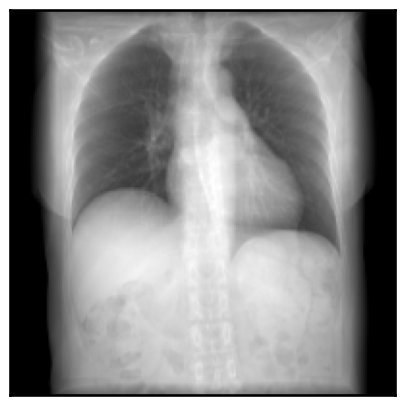

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0559\01-01-2000-NA-CT THORAX WCONTRAST-98352\10.000000-Segmentation of Nodule 1 - Annotation Nodule 001-.1653
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0560\01-01-2000-NA-CT LUNG SCREEN-02875\1.000000-Segmentation of Nodule 1 - Annotation Nodule 002-94281
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0561\01-01-2000-NA-CHEST-40141\30891.000000-ACRIN LARGE-98509
LIDC-IDRI-0561


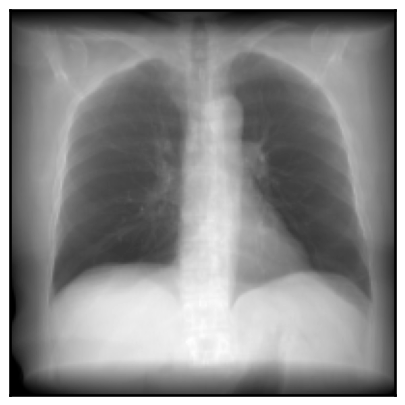

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0562\01-01-2000-NA-NA-32680\30040.000000-NA-82729
LIDC-IDRI-0562


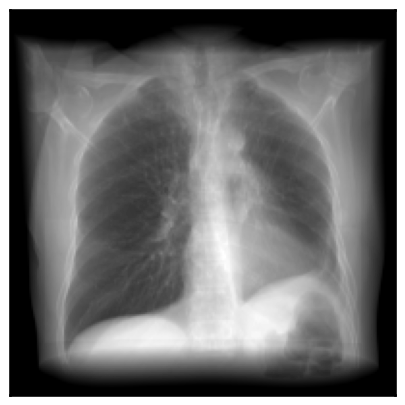

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0563\01-01-2000-NA-NA-16695\3000053.000000-NA-03514
LIDC-IDRI-0563


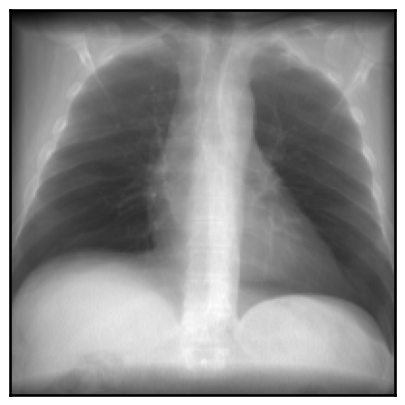

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0564\01-01-2000-NA-NA-77519\30802.000000-NA-23746
LIDC-IDRI-0564


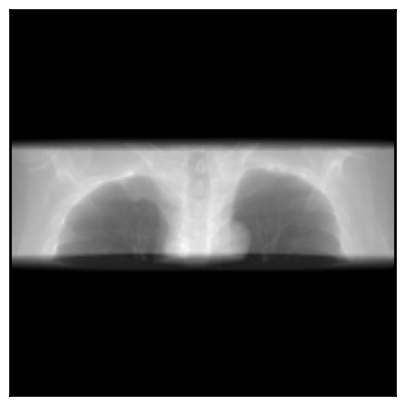

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0565\01-01-2000-NA-NA-84374\3000285.000000-NA-97985
LIDC-IDRI-0565


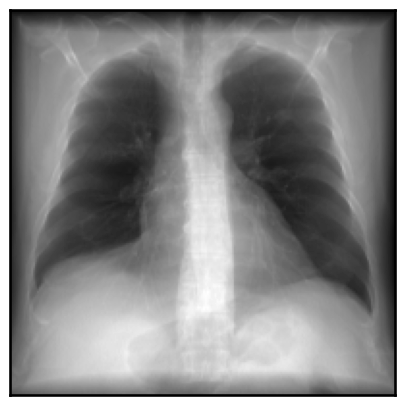

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0566\01-01-2000-NA-NA-63215\3000008.000000-NA-95628
LIDC-IDRI-0566


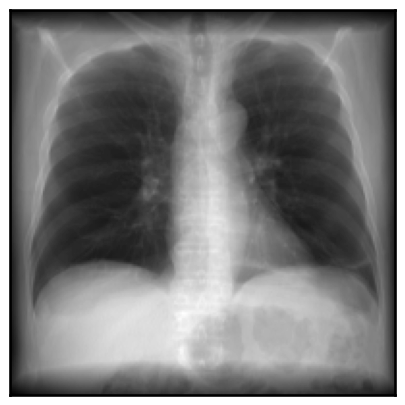

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0567\01-01-2000-NA-NA-35032\30068.000000-NA-49011
LIDC-IDRI-0567


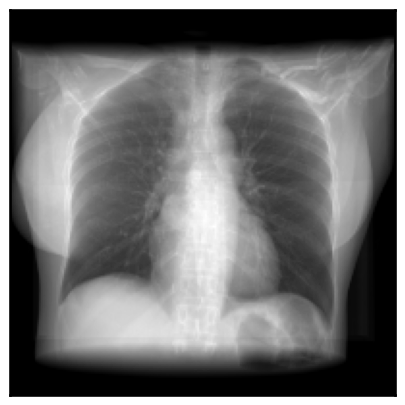

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0568\01-01-2000-NA-CT THORAX W IV CONTRAS-87975\31261.000000-NA-64474
LIDC-IDRI-0568


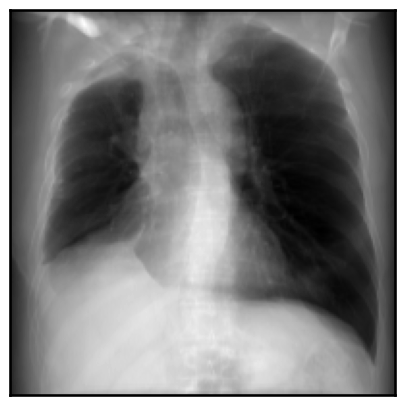

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0569\01-01-2000-NA-NA-91174\3000286.000000-NA-55637
LIDC-IDRI-0569


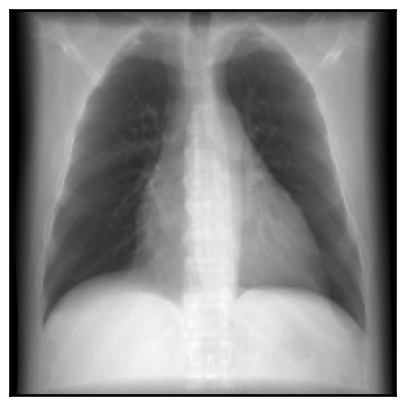

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0570\01-01-2000-NA-CT LUNG SCREEN-23771\1.000000-Segmentation of Nodule 1 - Annotation 15064-02565
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0571\01-01-2000-NA-CT LUNG SCREEN-22867\1.000000-Segmentation of Nodule 1 - Annotation 6899-71884
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0572\01-01-2000-NA-CHEST-03884\31067.000000-ACRIN LARGE-87949
LIDC-IDRI-0572


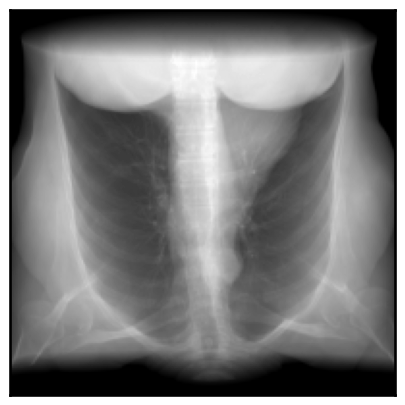

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0573\01-01-2000-NA-CT LUNG SCREEN-12285\NA-14534
LIDC-IDRI-0573


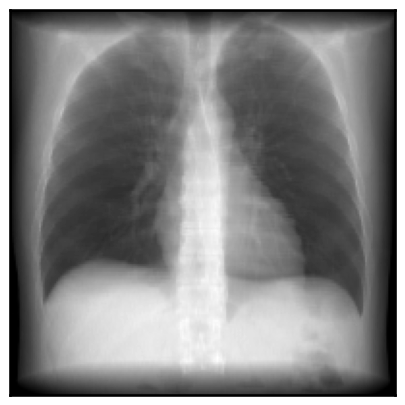

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0574\01-01-2000-NA-CT LUNG SCREEN-45855\1.000000-Segmentation of Nodule 1 - Annotation IL05769918-97288
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0575\01-01-2000-NA-NA-78878\30715.000000-NA-21294
LIDC-IDRI-0575


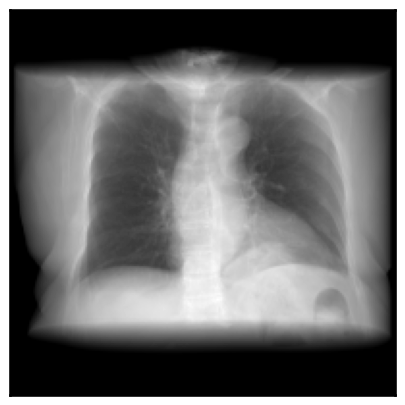

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0576\01-01-2000-NA-NA-74745\30051.000000-NA-98474
LIDC-IDRI-0576


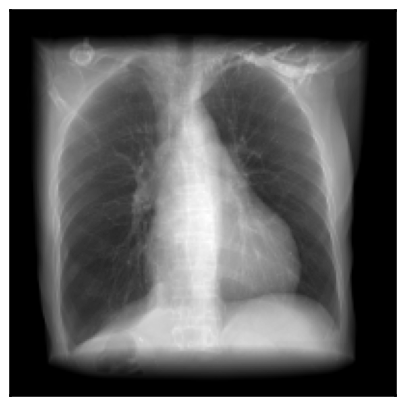

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0577\01-01-2000-NA-NA-78172\5490.000000-ThoraxRoutine  3.0  B31s-93067
LIDC-IDRI-0577


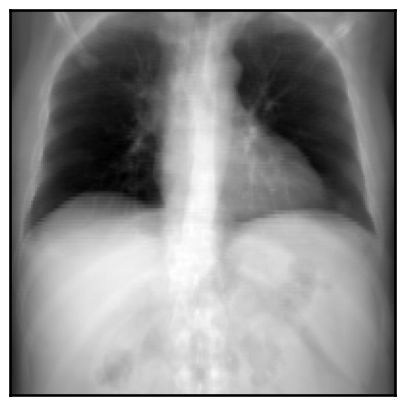

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0578\01-01-2000-NA-CHESTABDPELVIS-44681\10.000000-Nodule 1 - Annotation IL057202840 evaluations-17903
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0579\01-01-2000-NA-NA-32402\3000293.000000-NA-32756
LIDC-IDRI-0579


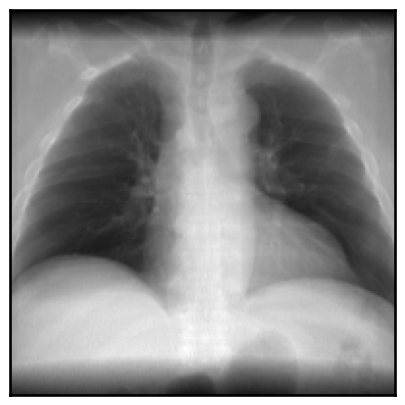

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0580\01-01-2000-1-NA-15860\1000.000000-QIN CT challenge alg01 run1segmentation result-09289
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0581\01-01-2000-NA-CT LUNG SCREEN-11056\1.000000-Segmentation of Nodule 1 - Annotation Nodule 003-74838
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0582\01-01-2000-NA-NA-26959\1438.000000-NLST TLC VOL B30F-66464
LIDC-IDRI-0582


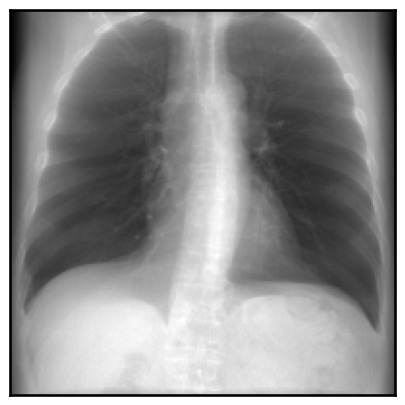

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0583\01-01-2000-NA-NA-18747\30077.000000-NA-81802
LIDC-IDRI-0583


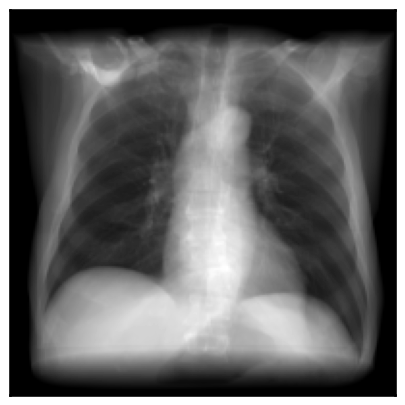

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0584\01-01-2000-NA-CHEST-75079\30968.000000-NA-20907
LIDC-IDRI-0584


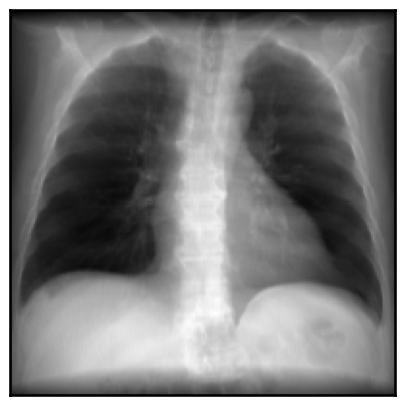

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0586\01-01-2000-NA-CT LUNG SCREEN-73021\1.000000-Segmentation of Nodule 1 - Annotation Nodule 001-61059
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0587\01-01-2000-NA-NA-72112\30058.000000-NA-61074
LIDC-IDRI-0587


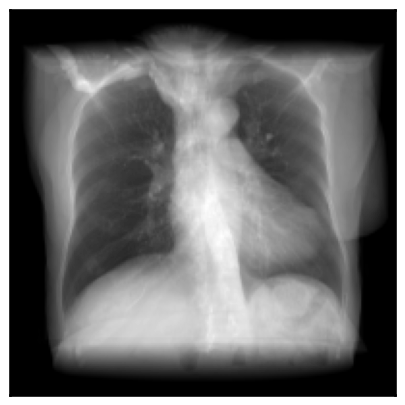

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0588\01-01-2000-NA-CT THORAX WCONTRAST-44257\3.000000-NA-90929
LIDC-IDRI-0588


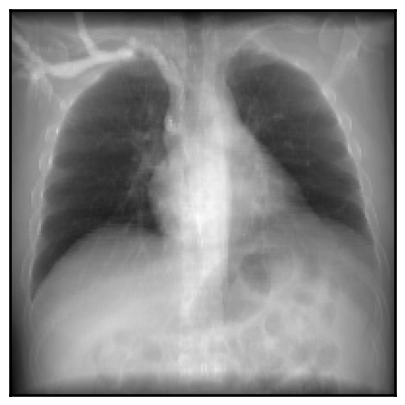

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0589\01-01-2000-NA-CT LUNG SCREEN-32018\NA-93123
LIDC-IDRI-0589


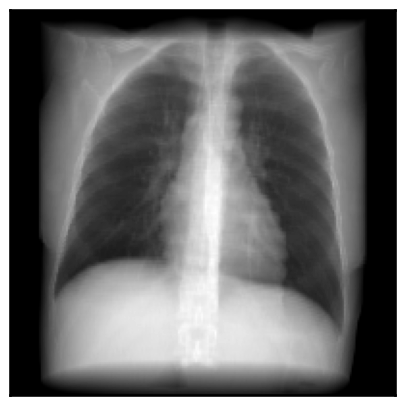

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0590\01-01-2000-NA-NA-58320\30726.000000-NA-08002
LIDC-IDRI-0590


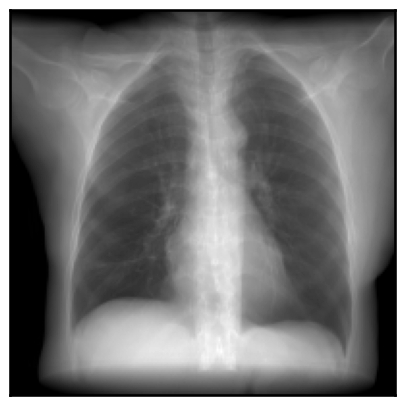

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0591\01-01-2000-NA-CT LUNG SCREEN-70869\1.000000-Segmentation of Nodule 1 - Annotation 5689-83227
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0592\01-01-2000-NA-CT LUNG SCREEN-53000\1.000000-Segmentation of Nodule 1 - Annotation 2617-21310
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0593\01-01-2000-NA-CHEST-90592\31174.000000-NA-02181
LIDC-IDRI-0593


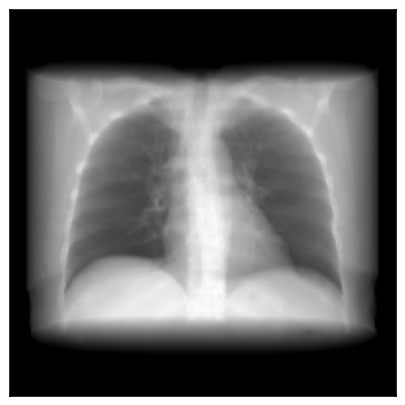

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0594\01-01-2000-NA-CT CHEST O CONTR-43117\1.000000-Segmentation of Nodule 1 - Annotation 7064-93871
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0595\01-01-2000-NA-NA-50972\5440.000000-NA-89637
LIDC-IDRI-0595


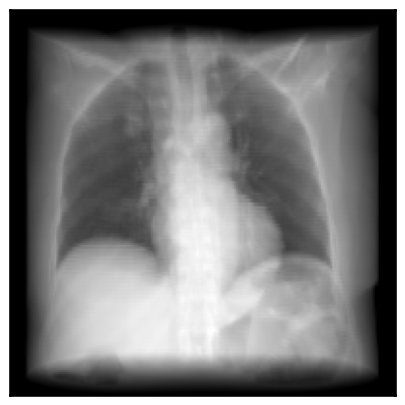

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0596\01-01-2000-NA-CT CHEST O CONTR-80891\1.000000-Segmentation of Nodule 1 - Annotation 4829-44118
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0597\01-01-2000-NA-NA-99673\5481.000000-NA-09376
LIDC-IDRI-0597


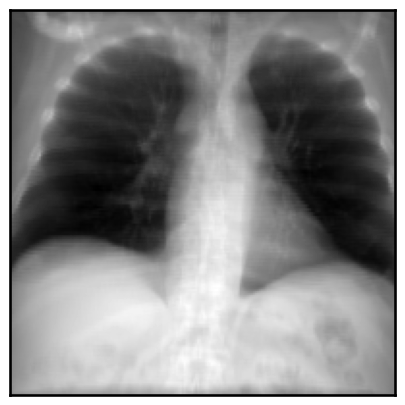

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0598\01-01-2000-NA-NA-70111\3000015.000000-NA-69356
LIDC-IDRI-0598


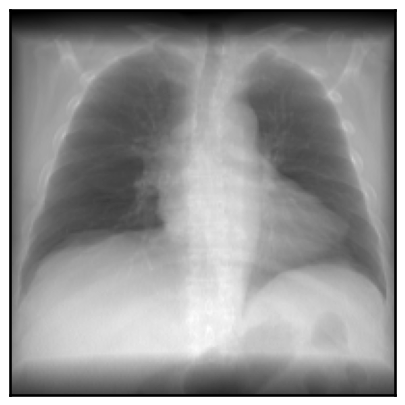

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0599\01-01-2000-NA-NA-92393\1996.000000-NLST TLC VOL B30F-98606
LIDC-IDRI-0599


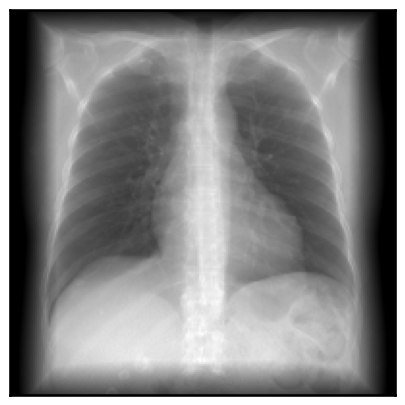

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0600\01-01-2000-NA-CT CHEST WO CONTRAST-13528\2.000000-NA-19680
LIDC-IDRI-0600


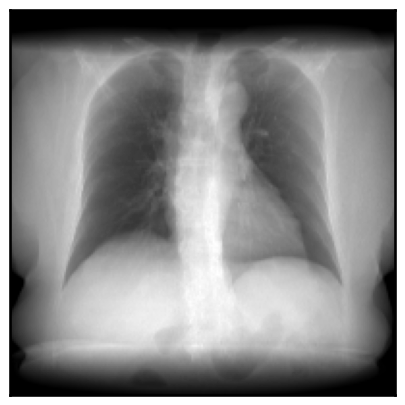

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0601\01-01-2000-NA-NA-68889\30047.000000-NA-56685
LIDC-IDRI-0601


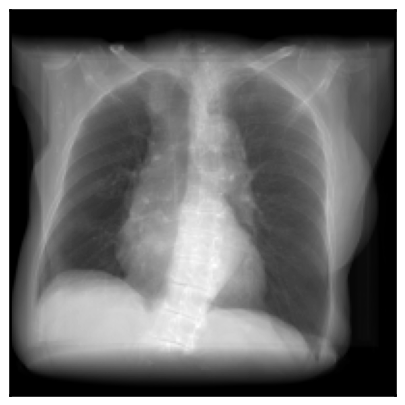

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0602\01-01-2000-NA-NA-30177\30048.000000-NA-93724
LIDC-IDRI-0602


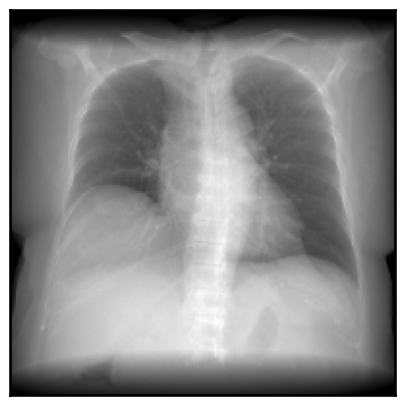

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0603\01-01-2000-NA-CT LUNG SCREEN-09505\NA-94647
LIDC-IDRI-0603


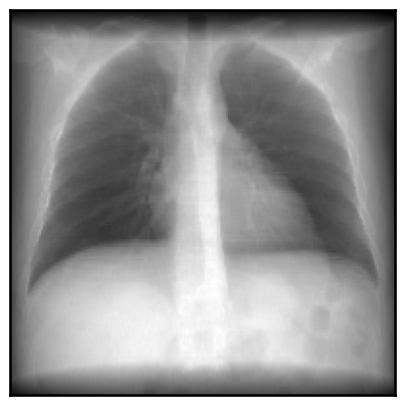

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0604\01-01-2000-NA-NA-47843\30780.000000-NA-06982
LIDC-IDRI-0604


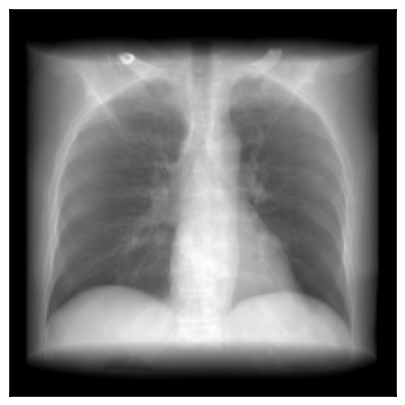

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0605\01-01-2000-NA-CHEST-48523\31058.000000-NA-59047
LIDC-IDRI-0605


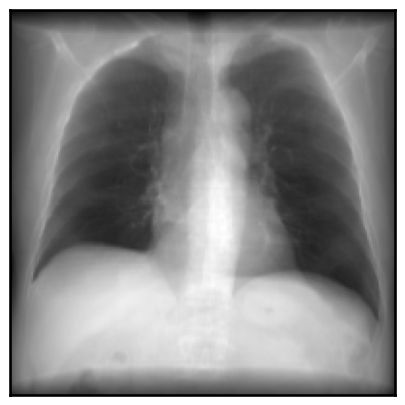

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0606\01-01-2000-NA-NA-89281\3617.000000-NLST0.6 B30f-38609
LIDC-IDRI-0606


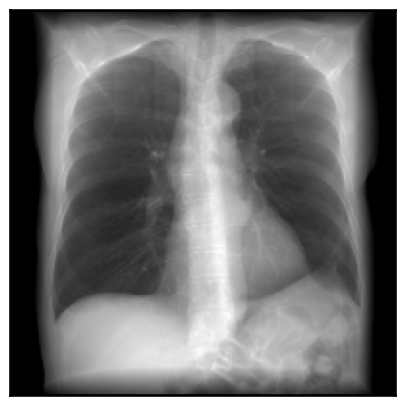

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0607\01-01-2000-NA-NA-04730\30082.000000-NA-50229
LIDC-IDRI-0607


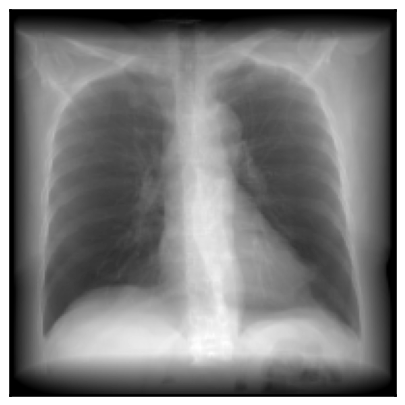

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0608\01-01-2000-NA-NA-27157\30022.000000-NA-06005
LIDC-IDRI-0608


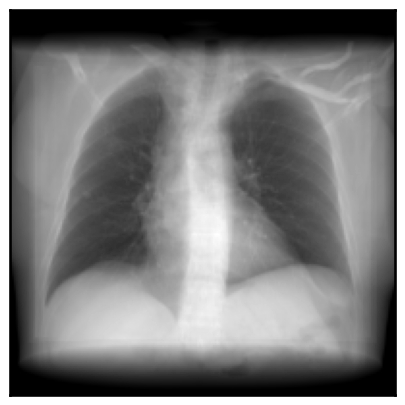

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0609\01-01-2000-NA-NA-42502\30764.000000-NA-97218
LIDC-IDRI-0609


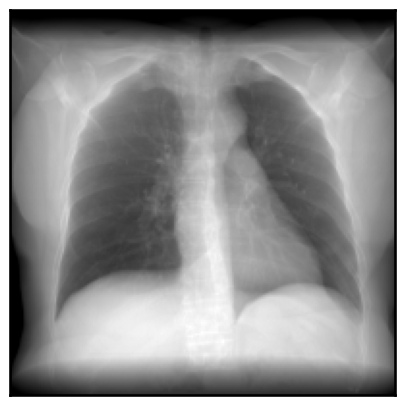

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0610\01-01-2000-NA-NA-35454\30363.000000-NA-81479
LIDC-IDRI-0610


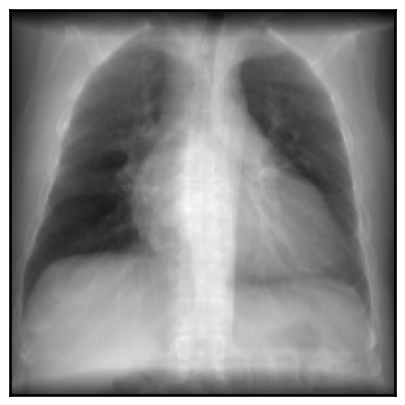

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0611\01-01-2000-NA-NA-40005\5468.000000-Routine Chest  3.0  B31s-90326
LIDC-IDRI-0611


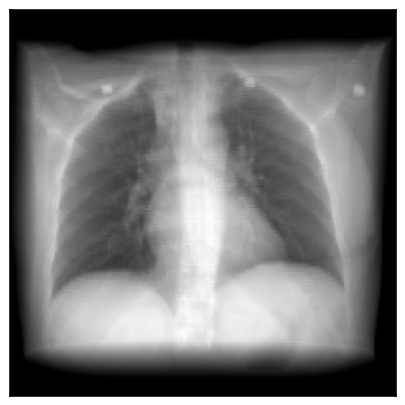

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0612\01-01-2000-NA-CT LUNG SCREEN-93403\NA-09530
LIDC-IDRI-0612


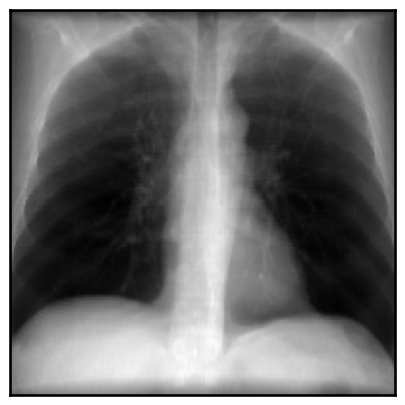

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0613\01-01-2000-NA-NA-71253\30052.000000-NA-55367
LIDC-IDRI-0613


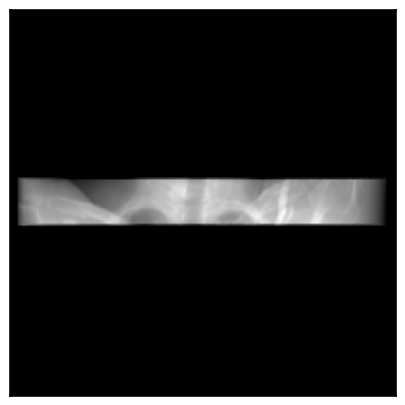

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0614\01-01-2000-NA-CHEST-89167\30983.000000-Recon 2 LOW DOSE THROUGH LUNGS-18641
LIDC-IDRI-0614


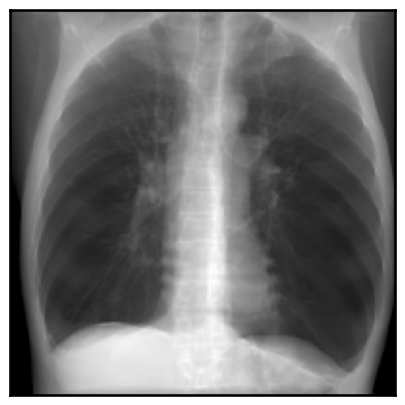

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0615\01-01-2000-NA-CHEST-92331\30885.000000-NA-87176
LIDC-IDRI-0615


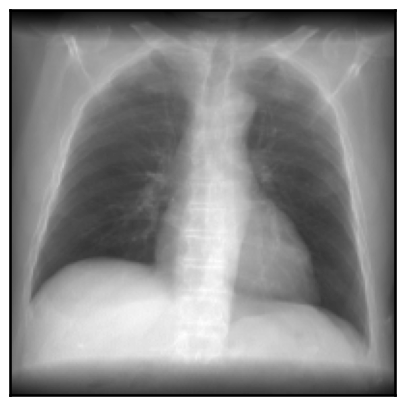

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0616\01-01-2000-NA-CT LUNG SCREEN-58233\NA-52904
LIDC-IDRI-0616


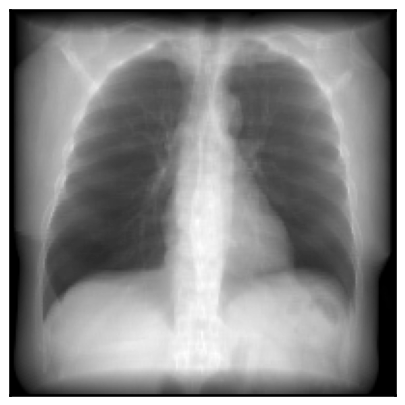

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0617\01-01-2000-NA-NA-51600\30081.000000-NA-14069
LIDC-IDRI-0617


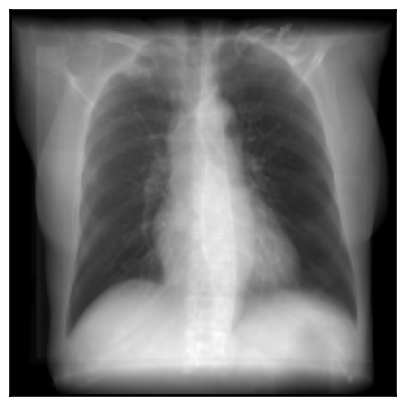

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0618\01-01-2000-NA-CT LUNG SCREEN-91452\1.000000-Segmentation of Nodule 1 - Annotation Nodule 003-74633
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0619\01-01-2000-NA-CT GUIDED LUNG B-79625\10.000000-Nodule 1 - Annotation 03565 evaluations-88550
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0620\01-01-2000-NA-CT LUNG SCREEN-20287\1.000000-Segmentation of Nodule 1 - Annotation Nodule 014-17179
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0621\01-01-2000-NA-NA-03312\3993.000000-NLST0.6 B30f-95820
LIDC-IDRI-0621


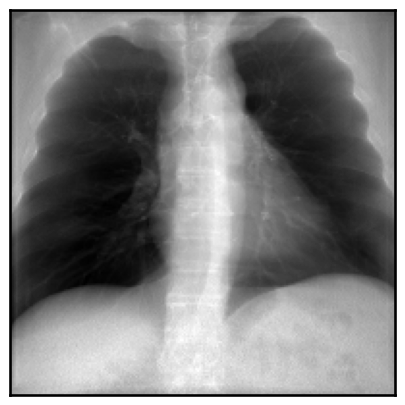

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0622\01-01-2000-NA-NA-63743\3000001.000000-NA-07488
LIDC-IDRI-0622


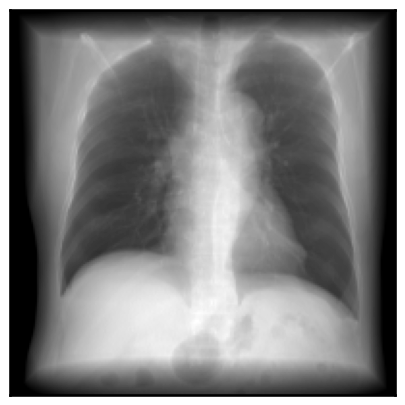

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0623\01-01-2000-NA-CT THORAX WO IV CONTRA-35260\32127.000000-Recon 2 ACRIN LARGE-37212
LIDC-IDRI-0623


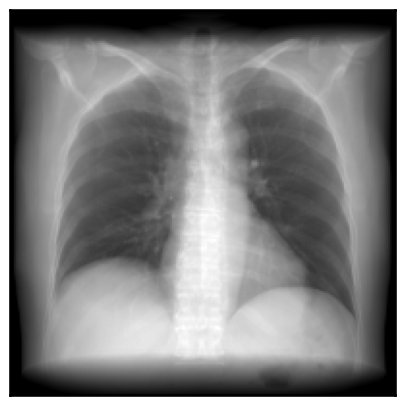

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0624\01-01-2000-NA-NA-13780\30071.000000-NA-98594
LIDC-IDRI-0624


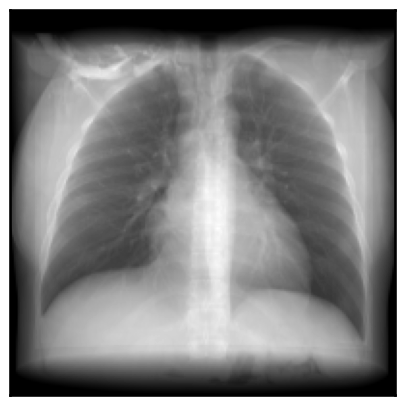

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0625\01-01-2000-NA-NA-38584\1560.000000-NLST TLC VOL B30F-74395
LIDC-IDRI-0625


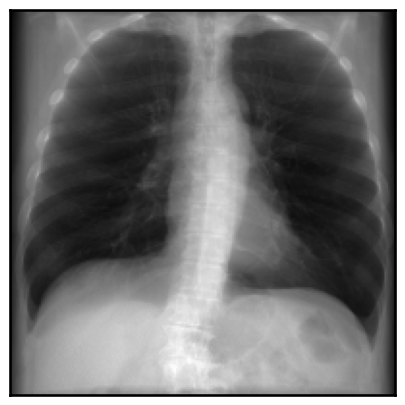

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0626\01-01-2000-NA-CT LUNG SCREEN-30781\1.000000-Segmentation of Nodule 1 - Annotation 8747-66643
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0627\01-01-2000-NA-CT LUNG SCREEN-49469\NA-39317
LIDC-IDRI-0627


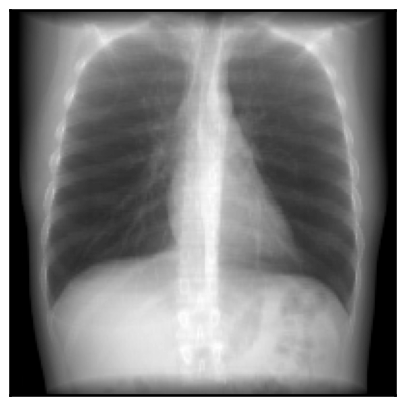

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0628\01-01-2000-NA-CT CHEST O CONTR-89373\1.000000-Segmentation of Nodule 1 - Annotation 5772-77314
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0629\01-01-2000-NA-NA-42287\30012.000000-NA-61822
LIDC-IDRI-0629


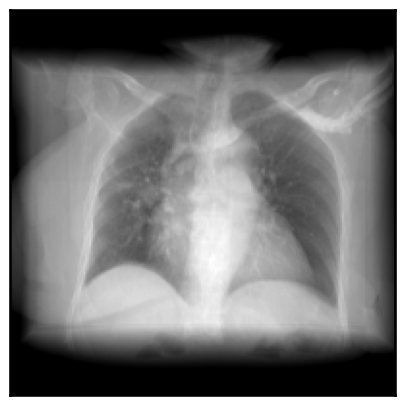

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0630\01-01-2000-NA-CT LUNG SCREEN-58813\1.000000-Segmentation of Nodule 1 - Annotation Nodule 003-00668
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0631\01-01-2000-NA-NA-69529\1465.000000-NLST TLC VOL B30F-19639
LIDC-IDRI-0631


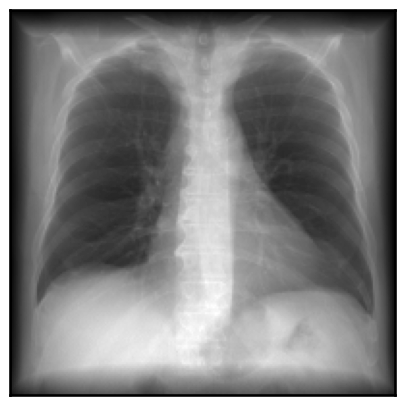

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0632\01-01-2000-NA-CT LUNG SCREEN-63313\NA-28517
LIDC-IDRI-0632


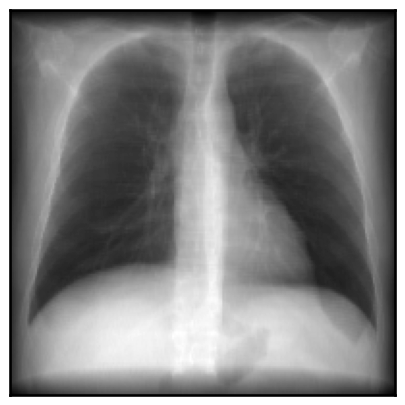

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0633\01-01-2000-NA-CHEST-38550\32224.000000-Recon 2-51767
LIDC-IDRI-0633


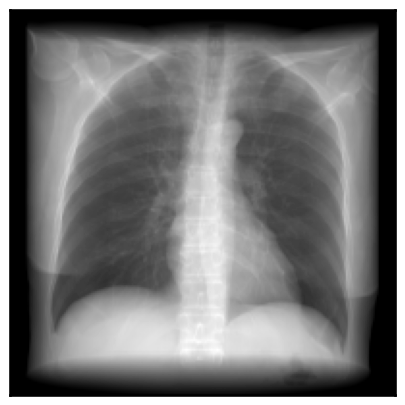

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0634\01-01-2000-NA-NA-42301\3000025.000000-NA-58100
LIDC-IDRI-0634


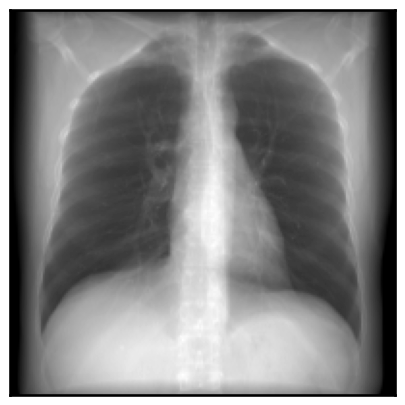

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0635\01-01-2000-NA-NA-57742\5444.000000-NA-10043
LIDC-IDRI-0635


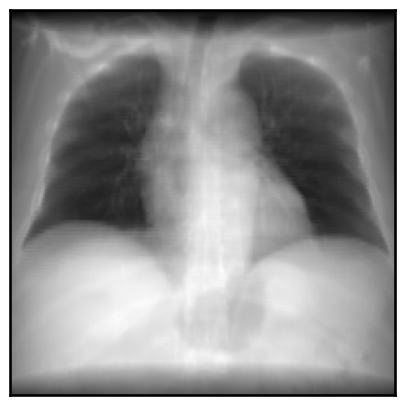

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0636\01-01-2000-NA-NA-88599\3000662.000000-NA-87559
LIDC-IDRI-0636


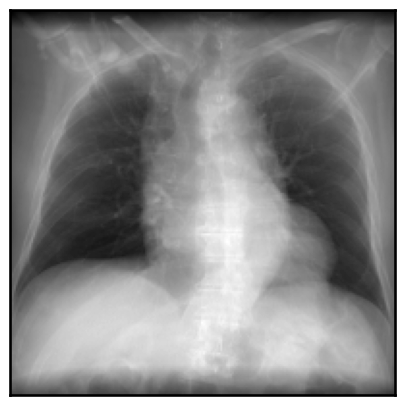

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0637\01-01-2000-NA-NA-58715\1731.000000-NLST TLC VOL B30F-19780
LIDC-IDRI-0637


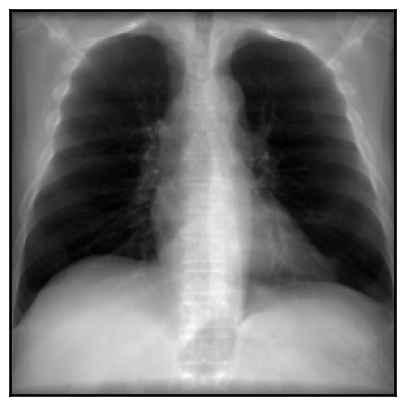

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0638\01-01-2000-NA-CHEST-98976\31045.000000-NA-35878
LIDC-IDRI-0638


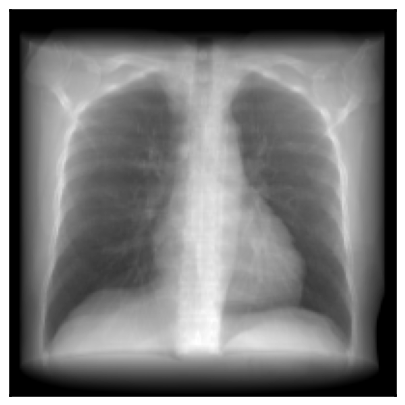

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0639\01-01-2000-NA-NA-37261\30748.000000-NA-73080
LIDC-IDRI-0639


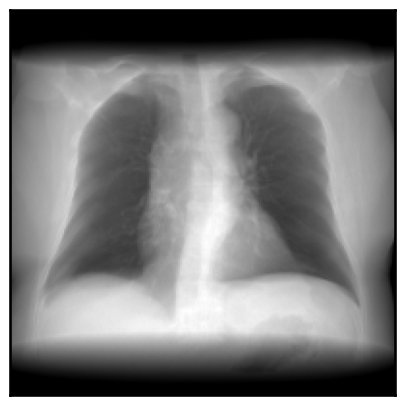

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0640\01-01-2000-NA-NA-73460\5446.000000-ThoraxRoutine  3.0  B31s-29989
LIDC-IDRI-0640


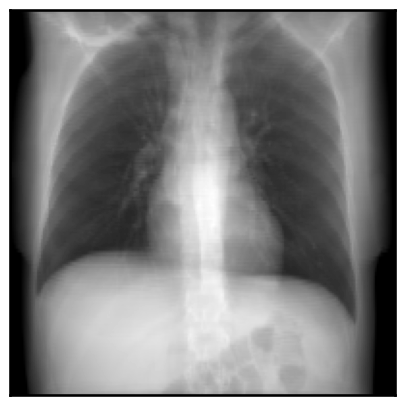

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0641\01-01-2000-NA-CHEST-55759\31163.000000-NA-34230
LIDC-IDRI-0641


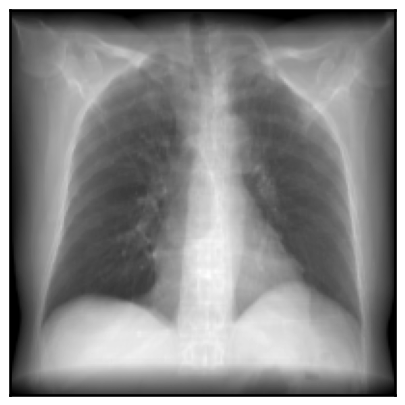

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0642\01-01-2000-NA-NA-64850\5750.000000-NA-39814
LIDC-IDRI-0642


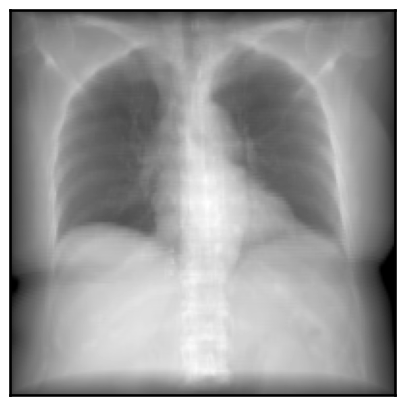

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0643\01-01-2000-NA-CT LUNG SCREEN-21068\1.000000-Segmentation of Nodule 1 - Annotation 9825-98132
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0644\01-01-2000-NA-NA-81205\30044.000000-NA-48683
LIDC-IDRI-0644


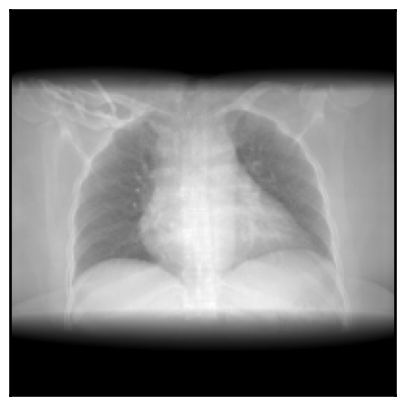

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0645\01-01-2000-NA-CT LUNG SCREEN-53655\1.000000-Segmentation of Nodule 1 - Annotation 6272-54349
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0646\01-01-2000-NA-NA-92895\4223.000000-NLST TLC VOL B30F-14604
LIDC-IDRI-0646


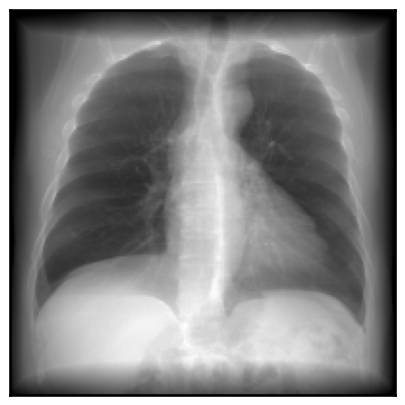

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0647\01-01-2000-NA-CHEST-44576\31501.000000-Recon 2-45596
LIDC-IDRI-0647


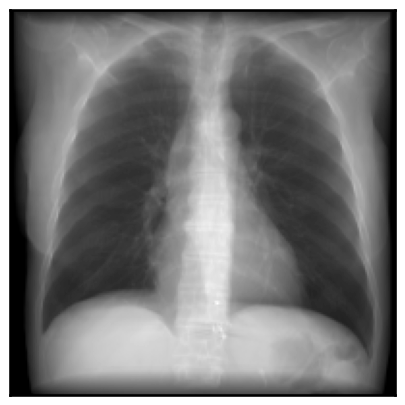

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0648\01-01-2000-NA-NA-56851\5927.000000-Airway  1.0  B31f-68939
LIDC-IDRI-0648


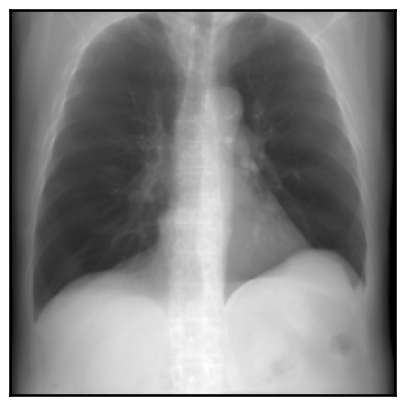

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0649\01-01-2000-NA-CT LUNG SCREEN-00055\1.000000-Segmentation of Nodule 1 - Annotation 0170-36526
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0650\01-01-2000-NA-CT CHEST O CONTR-98533\2.000000-NA-34609
LIDC-IDRI-0650


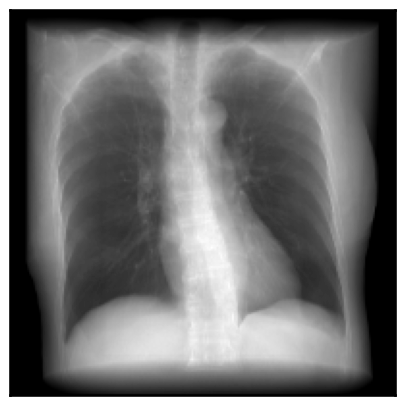

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0651\01-01-2000-NA-NA-00685\30041.000000-NA-30421
LIDC-IDRI-0651


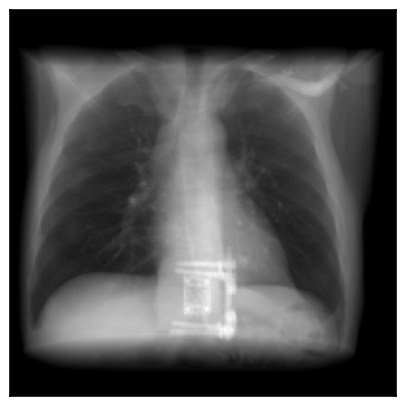

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0652\01-01-2000-NA-CHEST-12500\31192.000000-ACRIN LARGE-18048
LIDC-IDRI-0652


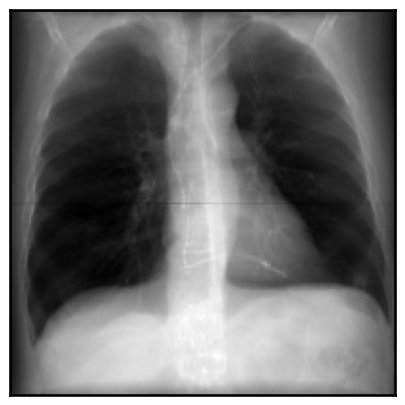

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0653\01-01-2000-NA-CT LUNG SCREEN-12682\NA-63325
LIDC-IDRI-0653


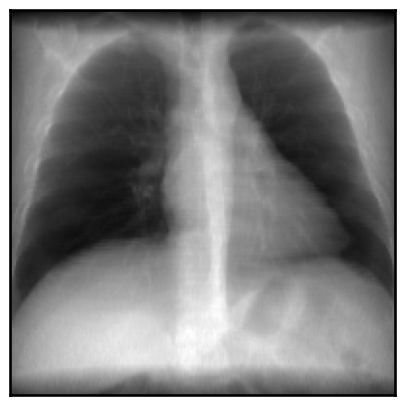

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0654\01-01-2000-NA-CT LUNG SCREEN-34461\1.000000-Segmentation of Nodule 1 - Annotation 5238-14777
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0655\01-01-2000-NA-NA-36060\1326.000000-NLST TLC VOL B30F-53512
LIDC-IDRI-0655


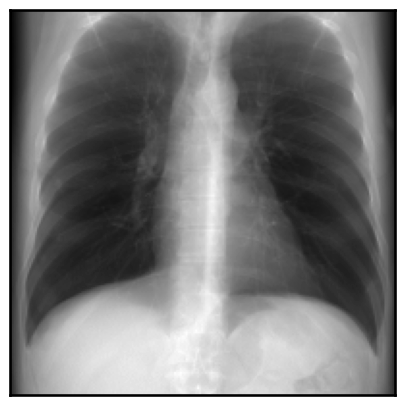

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0656\01-01-2000-NA-CT CHEST O CONTR-51770\10.000000-Nodule 1 - Annotation 3374 evaluations-52315
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0657\01-01-2000-NA-NA-72879\30702.000000-NA-29831
LIDC-IDRI-0657


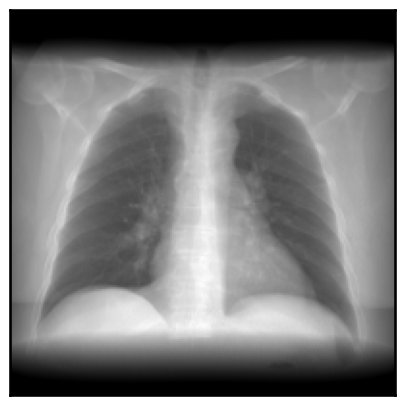

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0658\01-01-2000-NA-CT LUNG SCREEN-94591\1.000000-Segmentation of Nodule 1 - Annotation Nodule 001-81138
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0659\01-01-2000-NA-NA-29838\3000020.000000-NA-74972
LIDC-IDRI-0659


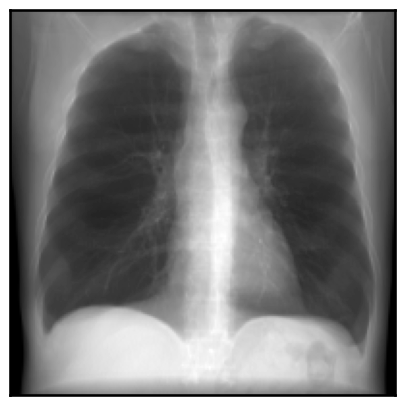

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0660\01-01-2000-NA-CT CHEST O CONTR-71530\10.000000-Nodule 3 - Annotation 0694 evaluations-44078
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0661\01-01-2000-NA-CT GUIDED LUNG B-01870\10.000000-Nodule 2 - Annotation Nodule 001 evaluations-74388
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0662\01-01-2000-NA-CT CHEST WO CONTRAST-80497\10.000000-Nodule 3 - Annotation Nodule 003 evaluations-99677
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0663\01-01-2000-NA-NA-82524\30817.000000-NA-65421
LIDC-IDRI-0663


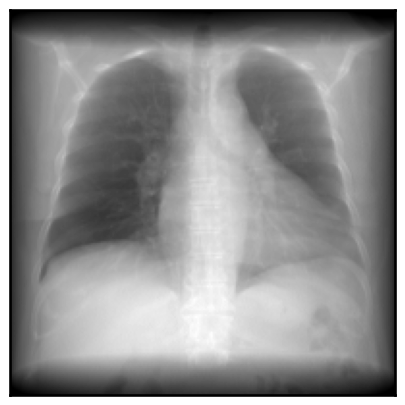

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0664\01-01-2000-NA-NA-62273\30765.000000-NA-76488
LIDC-IDRI-0664


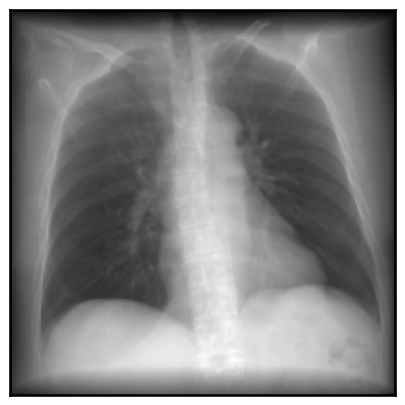

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0665\01-01-2000-NA-CHEST172-42132\32206.000000-Recon 2 ACRIN LARGE-67533
LIDC-IDRI-0665


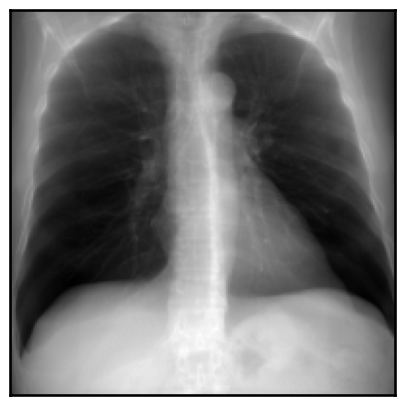

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0666\01-01-2000-NA-CHEST-90366\31033.000000-NA-93869
LIDC-IDRI-0666


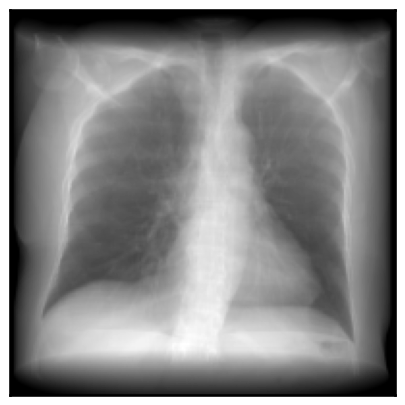

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0667\01-01-2000-NA-CHEST-06759\31215.000000-Recon 2 ACRIN LARGE-21616
LIDC-IDRI-0667


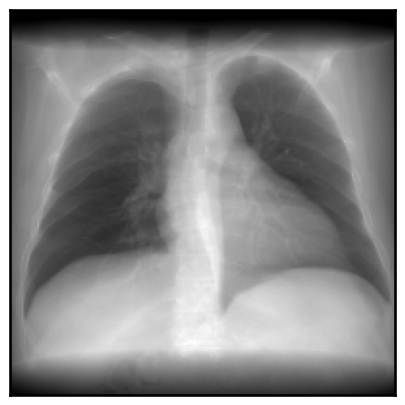

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0668\01-01-2000-NA-CT LUNG SCREEN-77041\NA-65787
LIDC-IDRI-0668


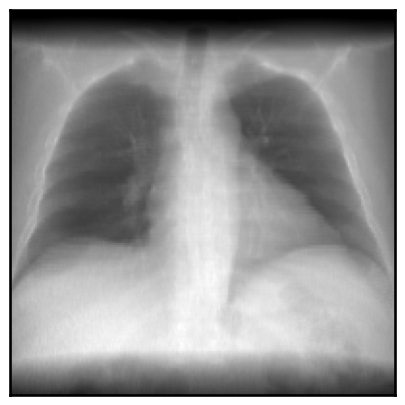

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0669\01-01-2000-NA-NA-23004\30814.000000-NA-40144
LIDC-IDRI-0669


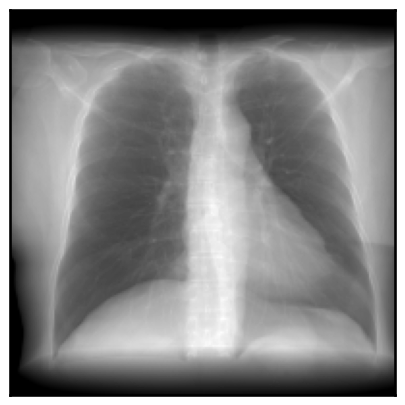

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0670\01-01-2000-NA-NA-72884\3000056.000000-NA-24196
LIDC-IDRI-0670


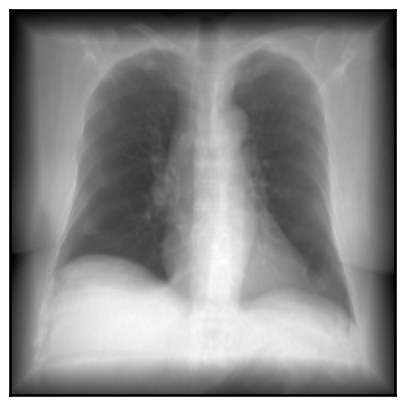

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0671\01-01-2000-NA-CT GUIDED LUNG B-74768\10.000000-Nodule 3 - Annotation IL057157566 evaluations-07952
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0672\01-01-2000-NA-CHEST-44829\31265.000000-Recon 2 ACRIN LARGE-35798
LIDC-IDRI-0672


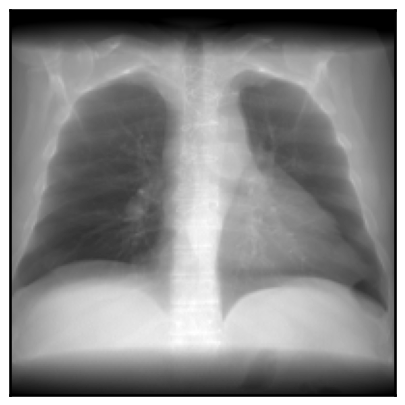

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0673\01-01-2000-NA-CT THORAX WO IV CONTRA-66360\31167.000000-Recon 2 ACRIN LARGE-53948
LIDC-IDRI-0673


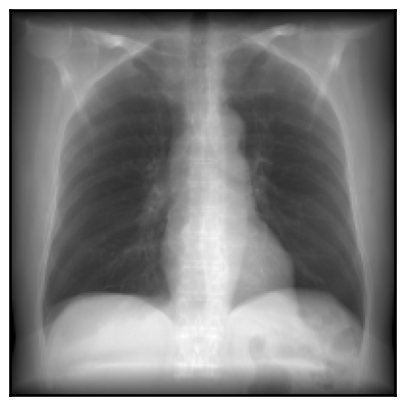

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0674\01-01-2000-NA-NA-30811\3000673.000000-NA-14021
LIDC-IDRI-0674


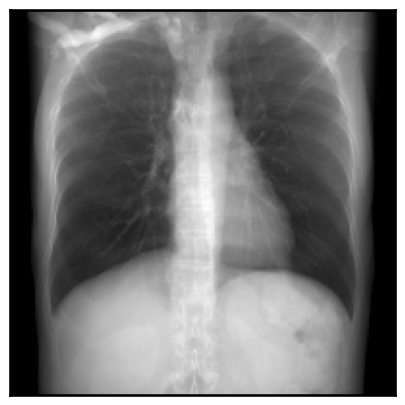

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0675\01-01-2000-NA-NA-36587\30070.000000-NA-89321
LIDC-IDRI-0675


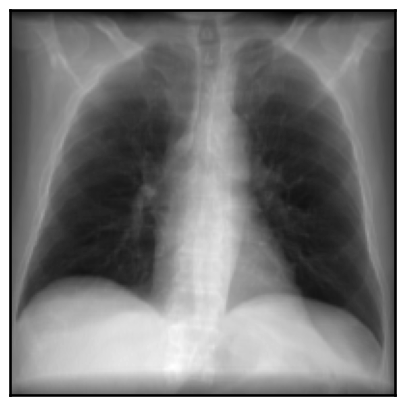

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0676\01-01-2000-NA-NA-36961\30341.000000-NA-61636
LIDC-IDRI-0676


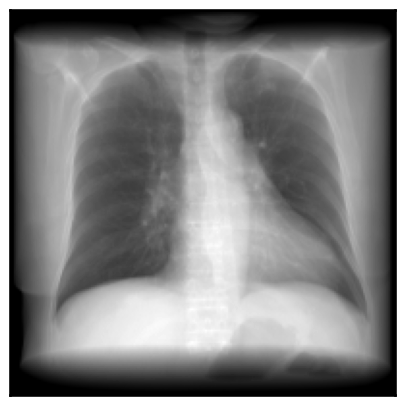

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0677\01-01-2000-NA-CHEST-25551\31169.000000-LOW DOSE THROUGH LUNGS-56859
LIDC-IDRI-0677


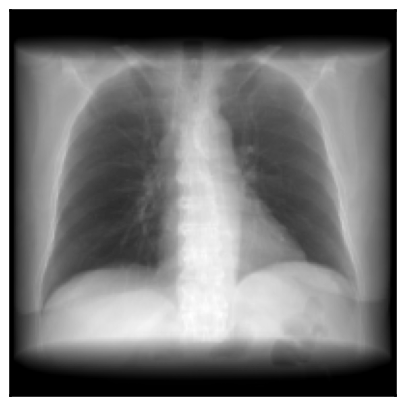

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0678\01-01-2000-NA-NA-72850\3000016.000000-NA-10450
LIDC-IDRI-0678


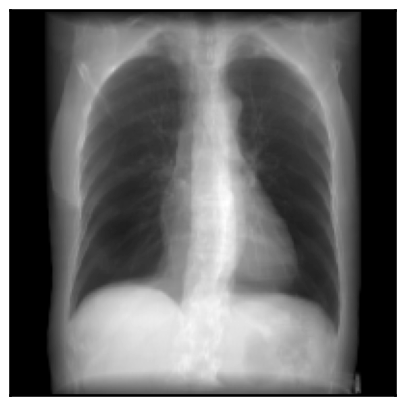

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0679\01-01-2000-NA-CT LUNG SCREEN-29026\NA-91305
LIDC-IDRI-0679


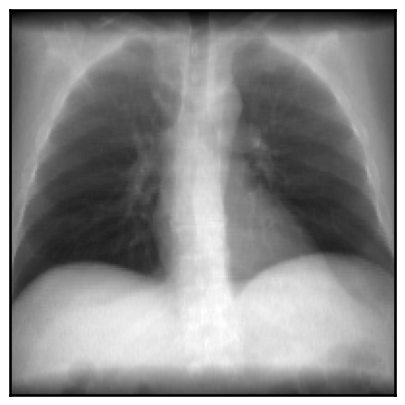

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0680\01-01-2000-NA-CT LUNG SCREEN-63697\1.000000-Segmentation of Nodule 1 - Annotation 7266-39863
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0681\01-01-2000-NA-CHEST-06344\31346.000000-Recon 2 ACRIN LARGE-62196
LIDC-IDRI-0681


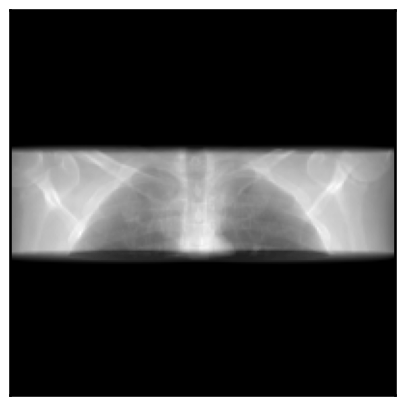

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0682\01-01-2000-NA-CT LUNG SCREEN-84785\1.000000-Segmentation of Nodule 1 - Annotation 2453-58462
C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0683\01-01-2000-NA-CT LUNG SCREEN-69732\NA-49727
LIDC-IDRI-0683


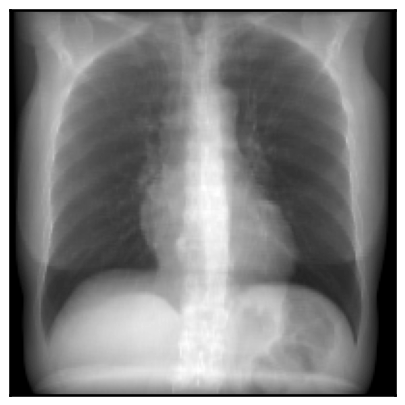

C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI\LIDC-IDRI-0684\01-01-2000-NA-NA-42842\30834.000000-NA-36987
LIDC-IDRI-0684


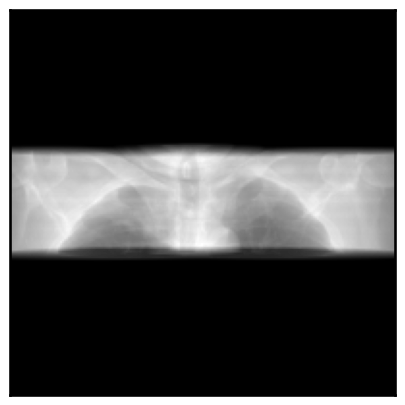

In [7]:
folder=r"C:\Users\PC\Desktop\data LIDC_IDRI\manifest-1712679618838\LIDC-IDRI"
for subfolder in os.listdir(folder):
    #list.append(str(os.path.join(folder,subfolder)))
    if subfolder=="LICENSE":
        continue
    link_subfolder=os.path.join(folder,subfolder)
    for subfolder1 in os.listdir(link_subfolder):
        folder_LIDC_IDRI=os.path.join(link_subfolder,subfolder1)
        sub1=next(os.walk(folder_LIDC_IDRI))[1]
        first_sub1=os.path.join(folder_LIDC_IDRI,sub1[0])
        print(first_sub1)
        num_files=len(os.listdir(first_sub1))
        if num_files>=10:
            print(subfolder)
            show(first_sub1)
        #len_folder=sum(os.path.join(first_sub1,item)) for item in os.listdir(first_sub1)
        